In [1]:
import pandas as pd
import yfinance 
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import matplotlib as matplotlib
import numpy as np
from datetime import datetime
import statsmodels.api as sm
import pickle
from scipy.signal import butter,filtfilt
from tslearn.clustering import TimeSeriesKMeans
from matplotlib import colors as mcolors
from sklearn.linear_model import LinearRegression

In [2]:
dj30=pd.read_csv('../../data/data/dj30/dj30.csv')

In [11]:
dj30_index = yfinance.download (tickers = "^DJI", start = "2012-01-03",
                              end = "2021-12-31", interval = "1wk")
dj30_index=dj30_index.rename({'Date': 'date', 'Adj Close': 'adjcp'}, axis=1) 

[*********************100%***********************]  1 of 1 completed


In [5]:
display(dj30)

,Unnamed: 0,date,open,high,low,close,adjcp,tic,zopen,zhigh,zlow,zadjcp,zclose,zd_5,zd_10,zd_15,zd_20,zd_25,zd_30
0,0,2012-01-03,14.621429,14.732143,14.607143,14.686786,12.575916,AAPL,-0.004450,0.003088,-0.005423,-0.143726,0.005374,-0.010348,-0.011415,0.002751,-0.061124,-0.072128,-0.126481
1,1,2012-01-04,14.642857,14.810000,14.617143,14.765714,12.643501,AAPL,-0.008320,0.002999,-0.010062,-0.143726,0.005374,-0.010348,-0.011415,0.002751,-0.061124,-0.072128,-0.126481
2,2,2012-01-05,14.819643,14.948214,14.738214,14.929643,12.783867,AAPL,-0.007368,0.001244,-0.012822,-0.143726,0.011102,-0.010348,-0.011415,0.002751,-0.061124,-0.072128,-0.126481
3,3,2012-01-06,14.991786,15.098214,14.972143,15.085714,12.917509,AAPL,-0.006226,0.000829,-0.007528,-0.143726,0.010454,-0.010348,-0.011415,0.002751,-0.061124,-0.072128,-0.126481
4,4,2012-01-09,15.196429,15.276786,15.048214,15.061786,12.897021,AAPL,0.008939,0.014275,-0.000901,-0.143726,-0.001586,-0.010348,-0.011415,0.002751,-0.061124,-0.072128,-0.126481
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72988,72988,2021-12-27,139.600006,140.869995,139.570007,140.759995,140.217682,WMT,-0.008241,0.000781,-0.008454,-0.003853,0.009105,-0.007005,0.005428,-0.001702,-0.005965,0.000262,0.004064
72989,72989,2021-12-28,140.600006,142.970001,140.600006,142.779999,142.229904,WMT,-0.015268,0.001331,-0.015268,-0.003853,0.014351,-0.016039,-0.009350,-0.013800,-0.019776,-0.013620,-0.011165
72990,72990,2021-12-29,142.660004,143.529999,142.320007,142.710007,142.160172,WMT,-0.000350,0.005746,-0.002733,-0.003853,-0.000490,-0.011226,-0.010427,-0.011113,-0.018369,-0.013554,-0.011524
72991,72991,2021-12-30,143.259995,143.699997,142.479996,143.169998,142.618393,WMT,0.000629,0.003702,-0.004819,-0.003853,0.003223,-0.009695,-0.015422,-0.011231,-0.019225,-0.017298,-0.014566


In [12]:
tics=dj30['tic'].unique()

In [13]:
dj30_dict={}

In [17]:
for tic in tics:
    tic_data=dj30.loc[dj30['tic']==tic,:]
    tic_data=tic_data.assign(pct_return=tic_data['adjcp'].pct_change().fillna(0))
#     display(tic_data)
    dj30_dict[tic]=tic_data.reset_index(drop=True)
#     print(tic)
#     display(dj30_dict[tic].iloc[0,:][['adjcp','pct_return']])
dj30_dict['DJI']=dj30_index

In [24]:
def apply_to_all(tics,dataset,function):
    for tic in tics:
        function(dataset[tic])
def plot_ori(data,name):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    ax.plot(data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')), data['adjcp'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'_adjcp',fontsize=20)
    ax.grid(True)
    fig.savefig('res/'+name+'_adjcp'+'.png')
def plot_pct(data,name):
    fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)
    ax.plot(data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')), data['pct_return'])
#     display(data['pct_return'])
    ax.xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax.set_title(name+'pct_return',fontsize=20)
    ax.grid(True)
    fig.savefig('res/'+name+'_pct_return'+'.png')
def plot_both(data,name):
    plot_ori(data,name)
    plot_pct(data,name)
def plot_filter(data,name,low=6, high=32, K=12):
    filtered_data=sm.tsa.filters.bkfilter(data[['adjcp','pct_return']],low,high,K)
    date=data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d'))
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot(date,filtered_data['adjcp_cycle'],label='adjcp_cycle')
    ax[1].plot(date,filtered_data['pct_return_cycle'],label='pct_return_cycle')
#     display(data['pct_return'])
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp_cycle',fontsize=20)
    ax[1].set_title(name+'_pct_return_cycle',fontsize=20)
    ax[0].grid(True)
    ax[1].grid(True)
def butter_lowpass_filter(data, Wn, order):
    # suppose the data is sample at 7Hz (7days / week) so fs=7 and fn=7/2, we would like to eliminate volatility on weekly scale, then we should have
    # Wn=1/(7/2)=2/7 
    b, a = butter(order, Wn, btype='low', analog=False)
#     print(b,a)
#     display(data)
    y = filtfilt(b, a, data)
    return y
def adjcp_apply_filter(data,Wn_adjcp,Wn_pct,order):
    data['adjcp_filtered']=butter_lowpass_filter(data['adjcp'], Wn_adjcp, order)
    data['pct_return_filtered']=butter_lowpass_filter(data['pct_return'], Wn_pct, order)
def plot_lowpassfilter(data,name):
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot(data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')), data['adjcp_filtered'])
    ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[0].set_title(name+'_adjcp_filtered',fontsize=20)
    ax[1].plot(data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')), data['pct_return_filtered'])
    ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
    ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    ax[1].set_title(name+'_pct_return_filtered',fontsize=20)
    fig.savefig('res/'+name+'filtered'+'.png')
def plot_with_cluster(data,name):
    cluster_num=data['adjcp_label'].unique().size
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    for i in range(cluster_num):
        ax[0].plot(np.where(data['adjcp_label']==i, data['adjcp_filtered'], None), color=colors[i], label='cat'+str(i))
    ax[0].set_title(name+'_adjcp_clustered',fontsize=20)
#     ax[0].xaxis.set_major_locator(mdates.YearLocator(base=1))
#     ax[0].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    
#     ax[1].set_xticks(data['adjcp_filtered'],labels=data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')))
#     ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
#     ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
#     ax[1].set_xticklabels(data['date'].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')))
# #     ax[1].xaxis.set_major_locator(mdates.YearLocator(base=1))
# #     ax[1].xaxis.set_major_formatter(mdates.DateFormatter('%Y-%M'))
    for i in range(cluster_num):
        ax[1].plot(np.where(data['pct_return_label']==i, data['pct_return_filtered'], None), color=colors[i], label='cat'+str(i))
    ax[1].set_title(name+'_pct_return_clustered',fontsize=20)
    fig.savefig('res/'+name+'_clustered'+'.png')
    plt.legend()
def dwt_clustering(cutoff,data_ori,tic,adjcp_timewindow,pct_return_timewindow):
#     display('data',data_ori)
#     display(data_ori['adjcp_filtered'])
#     display(adjcp_timewindow*(data_ori['adjcp_filtered'].size//adjcp_timewindow))
    data=data_ori.iloc[:adjcp_timewindow*(data_ori['adjcp_filtered'].size//adjcp_timewindow),:]
#     display('data2',data)
    adjcp_window_data=[data[['adjcp_filtered']][i*adjcp_timewindow:(i+1)*adjcp_timewindow].to_numpy().reshape(-1) for i in range(data['adjcp_filtered'].size//adjcp_timewindow)]
    data=data_ori.iloc[:pct_return_timewindow*(data_ori['adjcp_filtered'].size//pct_return_timewindow),:]
    pct_return_window_data=[data[['pct_return_filtered']][i*pct_return_timewindow:(i+1)*pct_return_timewindow].to_numpy().reshape(-1) for i in range(data['pct_return_filtered'].size//pct_return_timewindow)]
#     display(adjcp_window_data)
#         display(type(adjcp_window_data[0]))
#         display(adjcp_window_data[0].shape)

    adj_cp_model = TimeSeriesKMeans(n_clusters=3, metric="dtw",
                             max_iter=10)
    temp_1=adj_cp_model.fit_predict(np.stack(adjcp_window_data, axis=0))
#     display(temp_1.repeat(adjcp_timewindow).shape,temp_1[-1].repeat(data_ori.shape[0]-temp_1.shape[0]*adjcp_timewindow).shape)
    dj30_dict[tic]['adjcp_label']=np.concatenate((temp_1.repeat(adjcp_timewindow),temp_1[-1].repeat(data_ori.shape[0]-temp_1.shape[0]*adjcp_timewindow)), axis=0)
    pct_return_model = TimeSeriesKMeans(n_clusters=3, metric="dtw",
                             max_iter=10)
    temp_2=pct_return_model.fit_predict(np.stack(pct_return_window_data,axis=0))
    dj30_dict[tic]['pct_return_label']=np.concatenate((temp_2.repeat(pct_return_timewindow),temp_2[-1].repeat(data_ori.shape[0]-temp_2.shape[0]*pct_return_timewindow)),axis=0)
def find_index_of_turning(data):
    turning_points=[0]
    data=data.reset_index(drop=True)
    for i in range(data['pct_return_filtered'].size-1):
#         display(data['pct_return_filtered'][i])
        if data['pct_return_filtered'][i]*data['pct_return_filtered'][i+1]<0:
            turning_points.append(i+1)
    if turning_points[-1]!=data['pct_return_filtered'].size:
        turning_points.append(data['pct_return_filtered'].size)
    return turning_points
def linear_regession_turning_points(data_ori,tic):
    data=data_ori.reset_index(drop=True)
    turning_points=find_index_of_turning(data)
    coef_list=[]
    y_pred_list=[]
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
#         print(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        adj_cp_model = LinearRegression().fit(x_seg,data['adjcp_filtered'].iloc[turning_points[i]:turning_points[i+1]])
        y_pred = adj_cp_model.predict(x_seg)
        coef_list.append(adj_cp_model.coef_)
        y_pred_list.append(y_pred)
    return np.asarray(coef_list),np.asarray(turning_points),y_pred_list
def linear_regession_plot(data,tic,y_pred_list,turning_points,percent_25,percent_75):
    data=data.reset_index(drop=True)
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    seg1,seg2,seg3=sorted([percent_25,percent_75,0])
    colors = list(dict(mcolors.BASE_COLORS, **mcolors.CSS4_COLORS).keys())
    for i in range(len(turning_points)-1):
        x_seg=np.asarray([j for j in range(turning_points[i],turning_points[i+1])]).reshape(-1, 1)
        y_pred = y_pred_list[i]
        coef=coef_list[i]
        if coef<=seg1:
            flag=0
        elif coef>seg1 and coef<=seg2:
            flag=1
        elif coef>seg2 and coef<=seg3:
            flag=2
        elif coef>seg3:
            flag=3
        ax[1].plot(x_seg,y_pred,color=colors[flag], label='cat'+str(flag))
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())
    fig.savefig('res/linear_model/'+tic+'.png')
def linear_regession(data_ori,tic,adjcp_timewindow):
    data=data_ori.iloc[:adjcp_timewindow*(data_ori['adjcp_filtered'].size//adjcp_timewindow),:]
    adjcp_window_data=[data[['adjcp_filtered']][i*adjcp_timewindow:(i+1)*adjcp_timewindow].to_numpy().reshape(-1) for i in range(data['adjcp_filtered'].size//adjcp_timewindow)]
    coef_list=[]
    fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)
    ax[0].plot([i for i in range(data.shape[0])], data['adjcp_filtered'])
    for i,data_seg in enumerate(adjcp_window_data):
        x_seg=np.asarray([i*adjcp_timewindow+j for j in range(adjcp_timewindow)]).reshape(-1, 1)
        adj_cp_model = LinearRegression().fit(x_seg,data_seg)
        y_pred = adj_cp_model.predict(x_seg)
        ax[1].plot([i*adjcp_timewindow+j for j in range(adjcp_timewindow)],y_pred)
        coef_list.append(adj_cp_model.coef_)
    return coef_list

# Basic manipulation

In [16]:
display(dj30_dict['KO'][['adjcp','pct_return']])

TypeError: 'NoneType' object is not subscriptable

In [340]:
!pwd

/home/zcxia/TradeMaster/labeling/statistical method


/tmp/ipykernel_3923687/2397279041.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


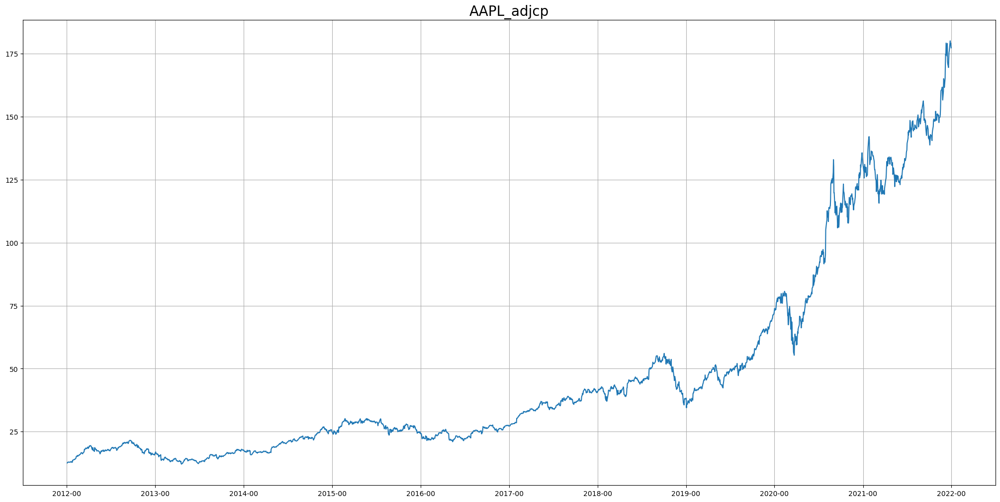

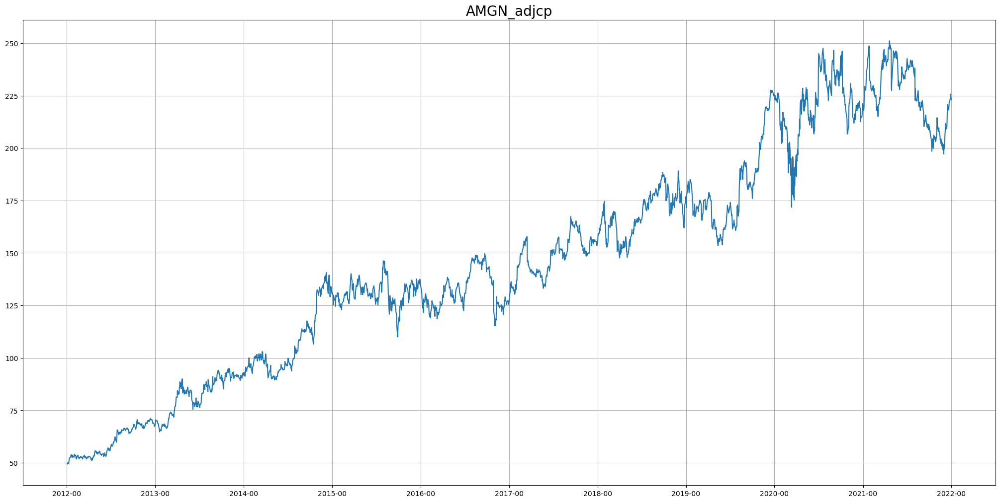

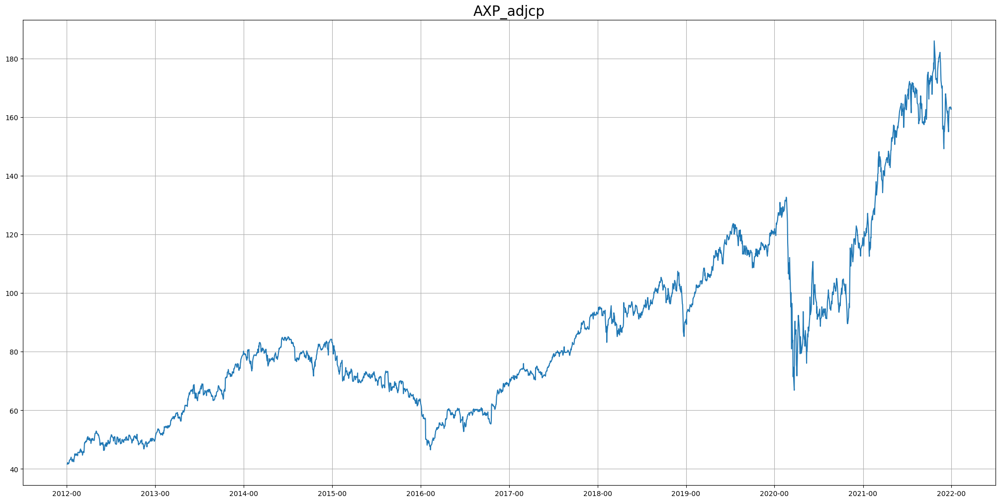

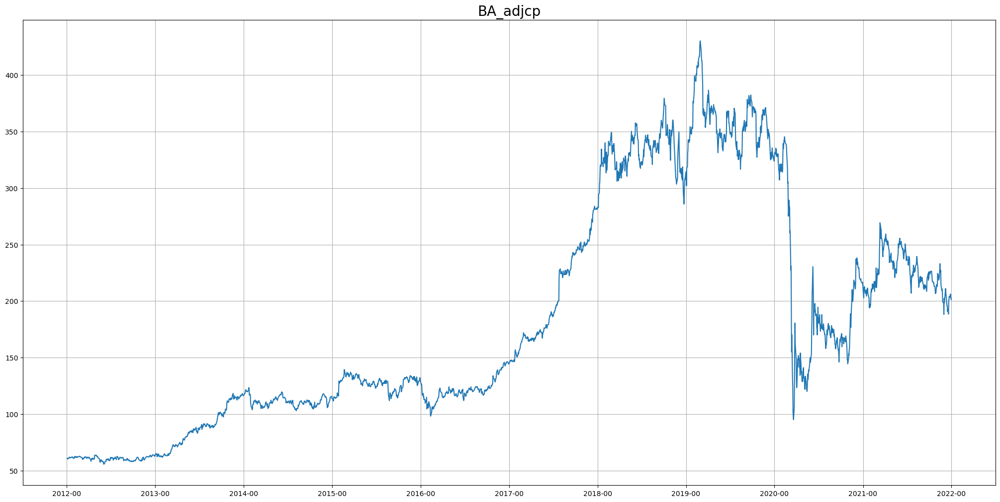

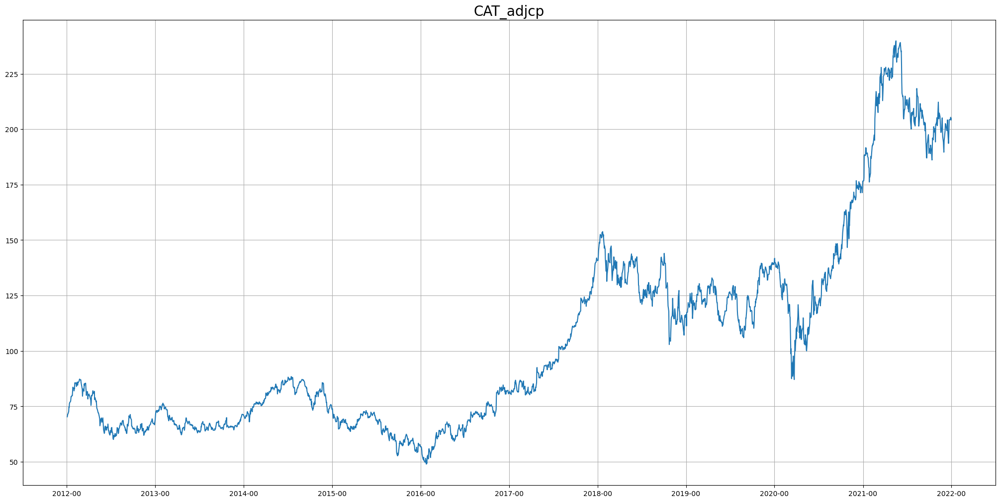

...

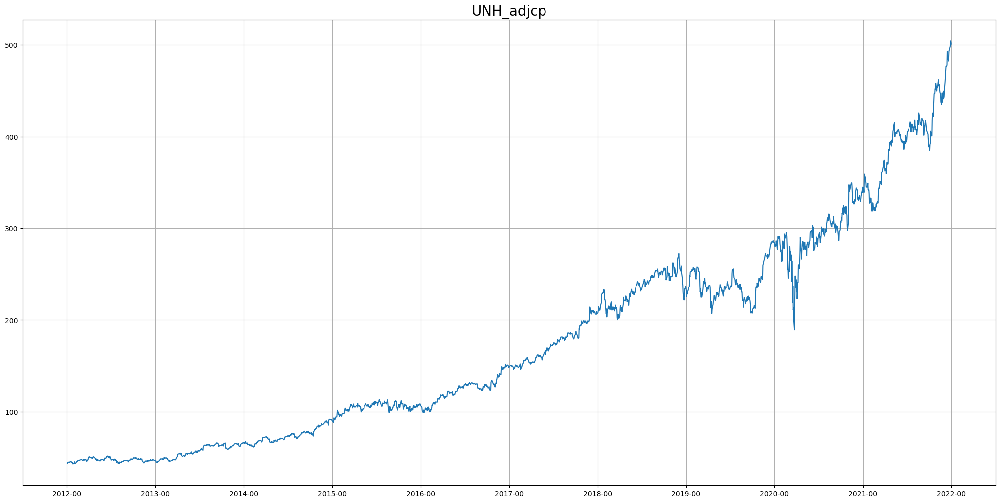

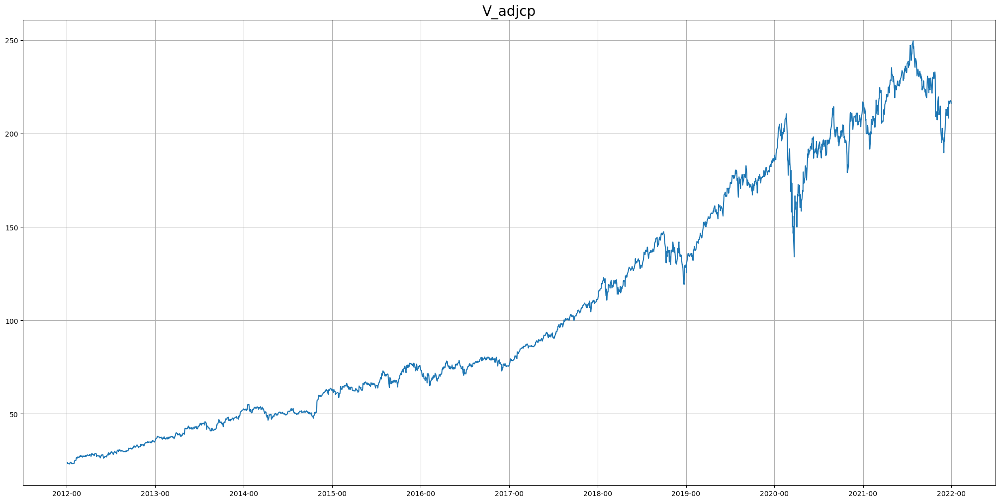

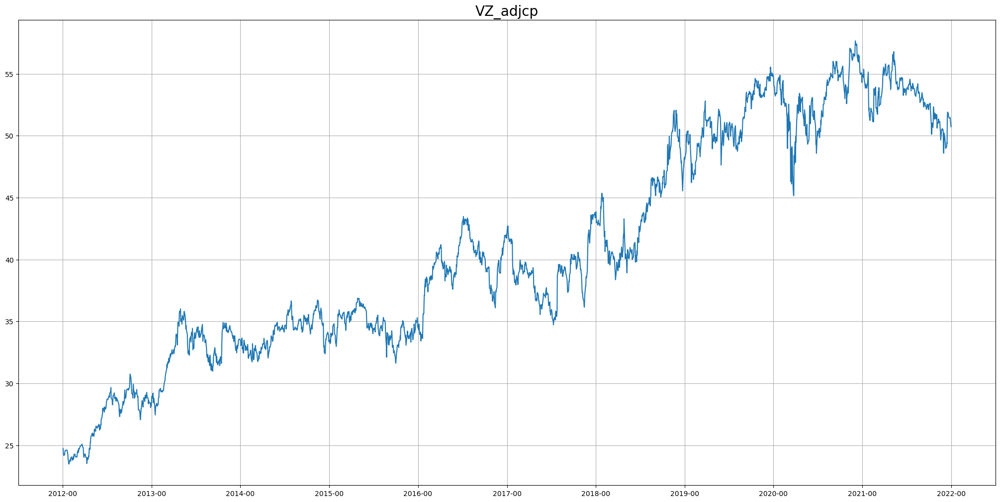

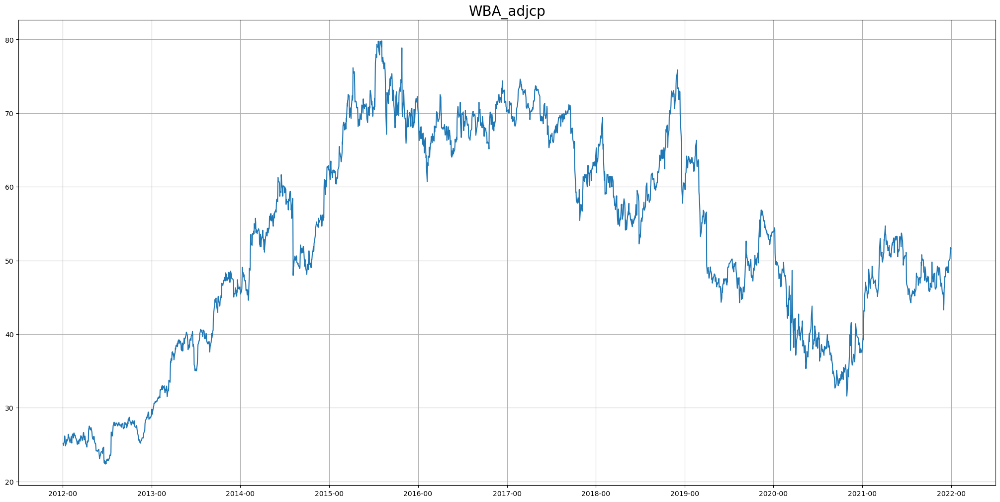

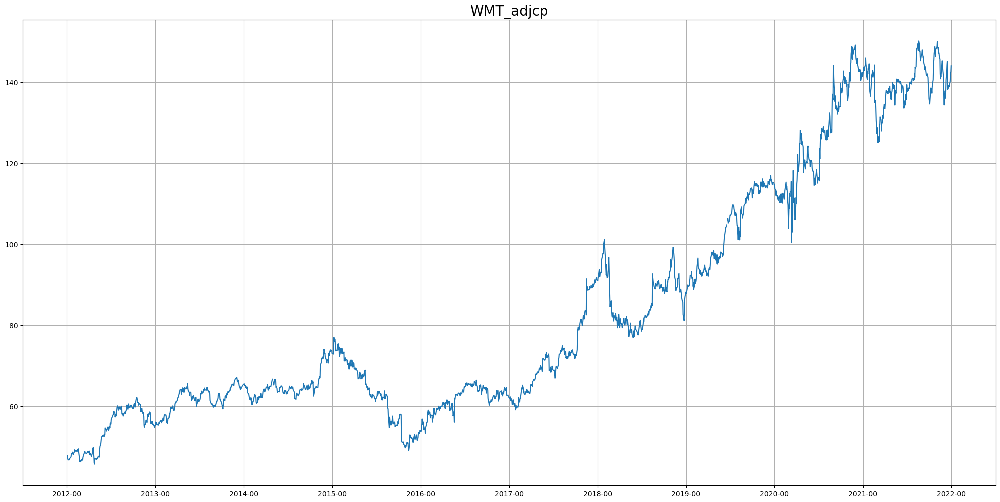

In [346]:
for tic in tics:
    plot_ori(dj30_dict[tic],tic)

/tmp/ipykernel_3923687/2397279041.py:13: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


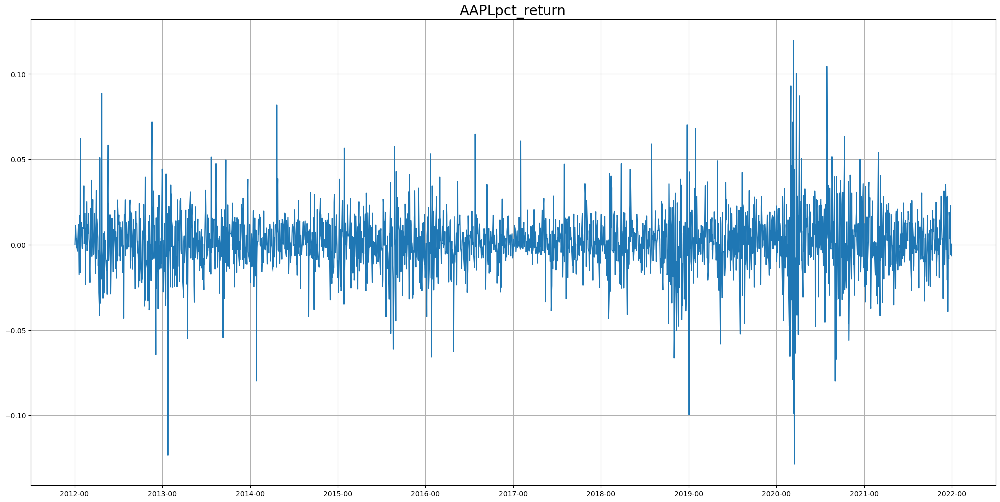

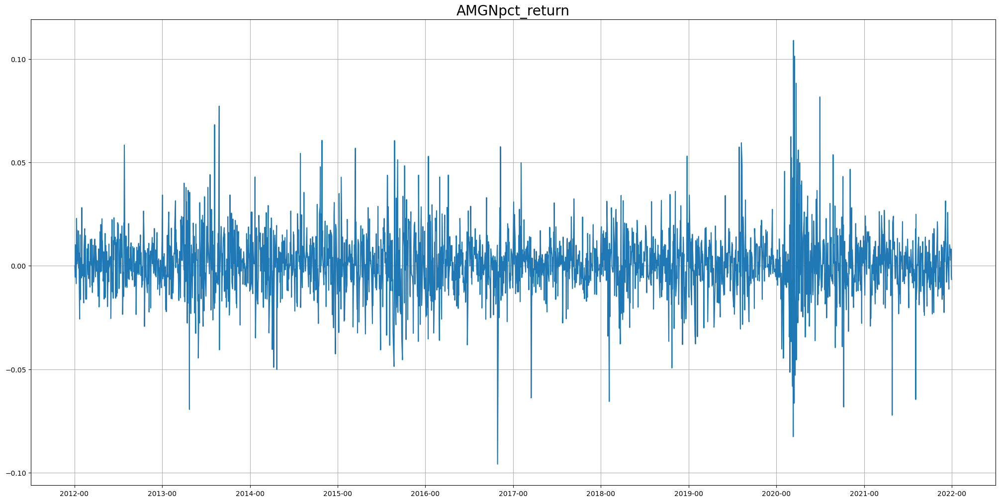

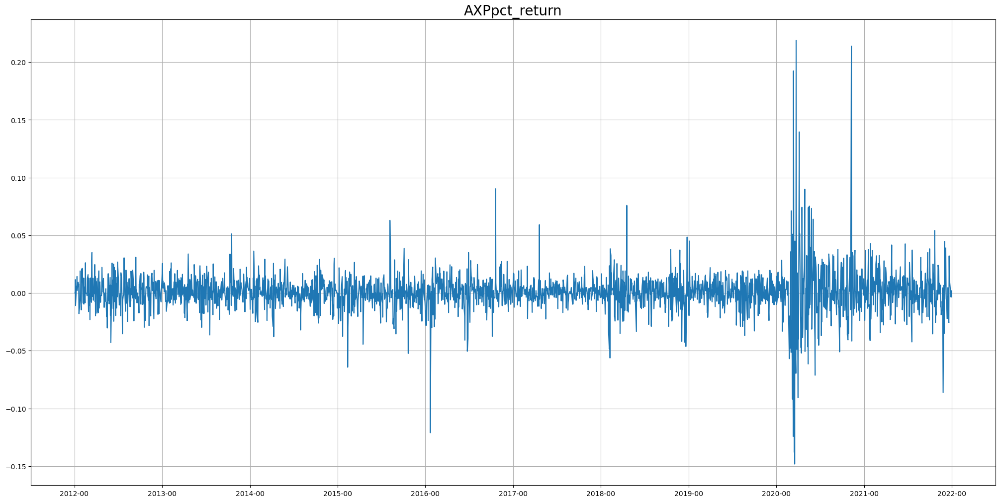

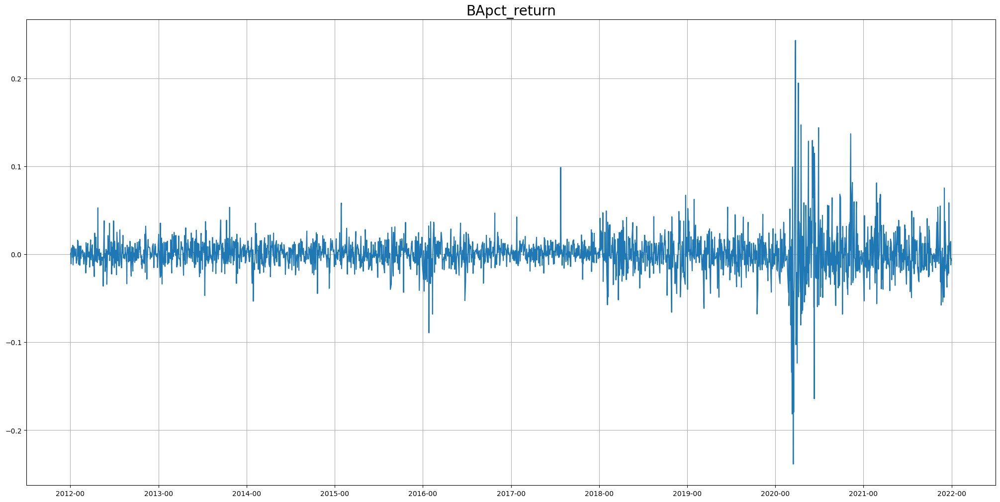

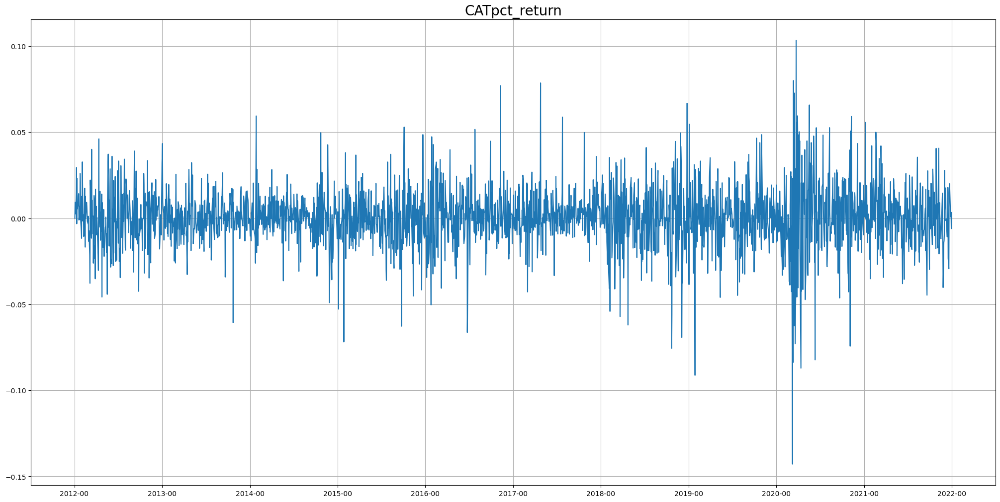

...

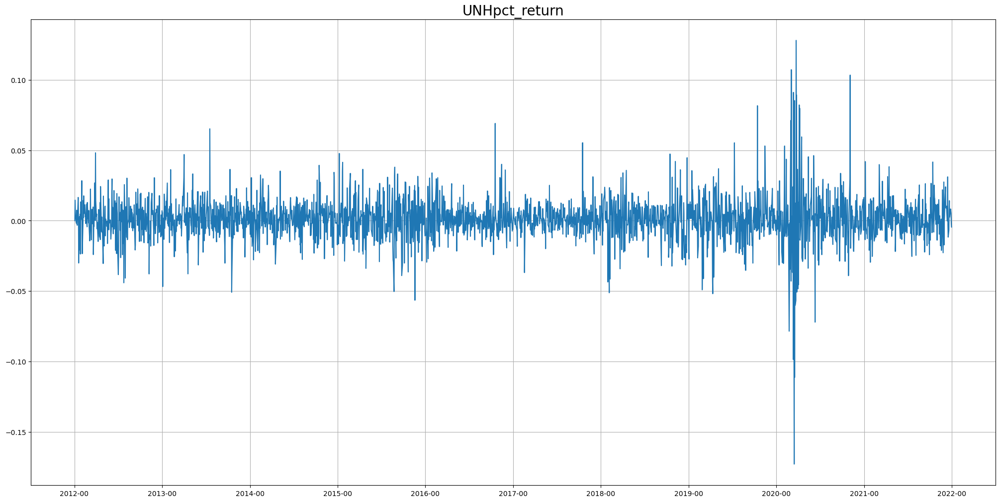

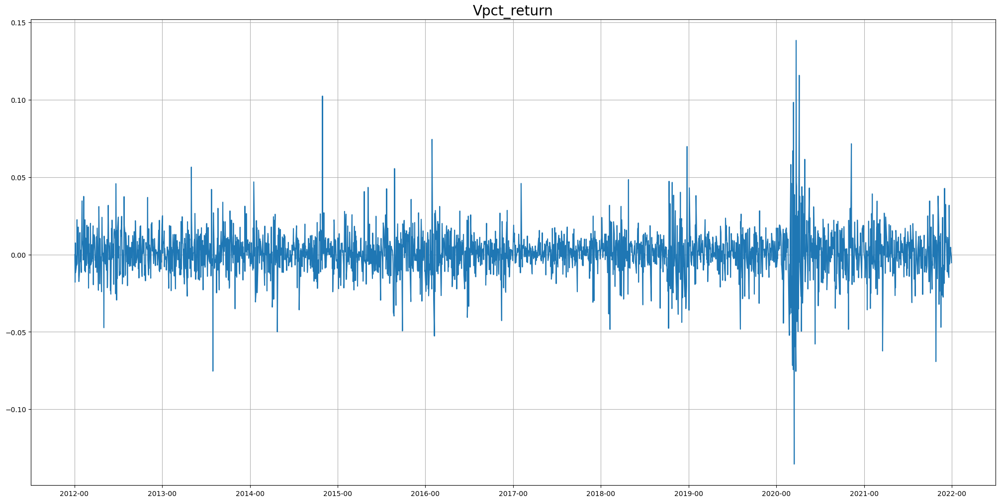

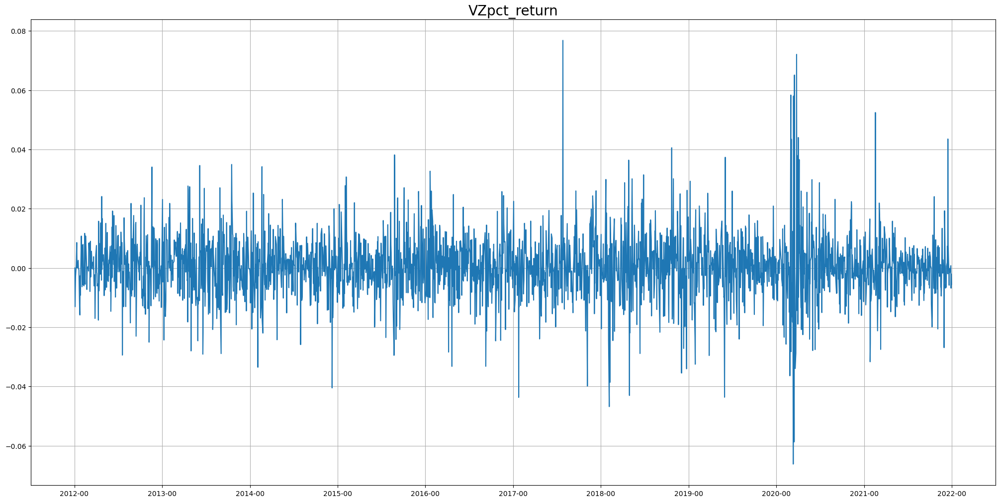

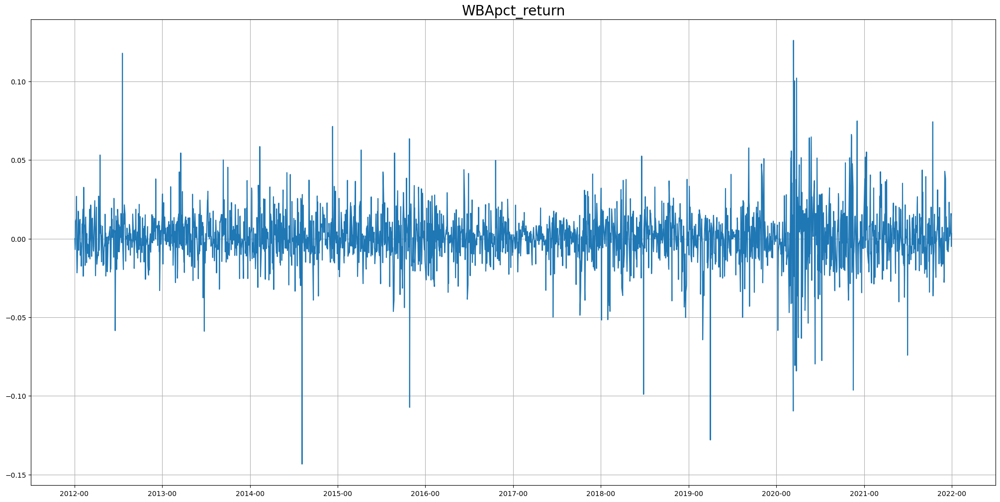

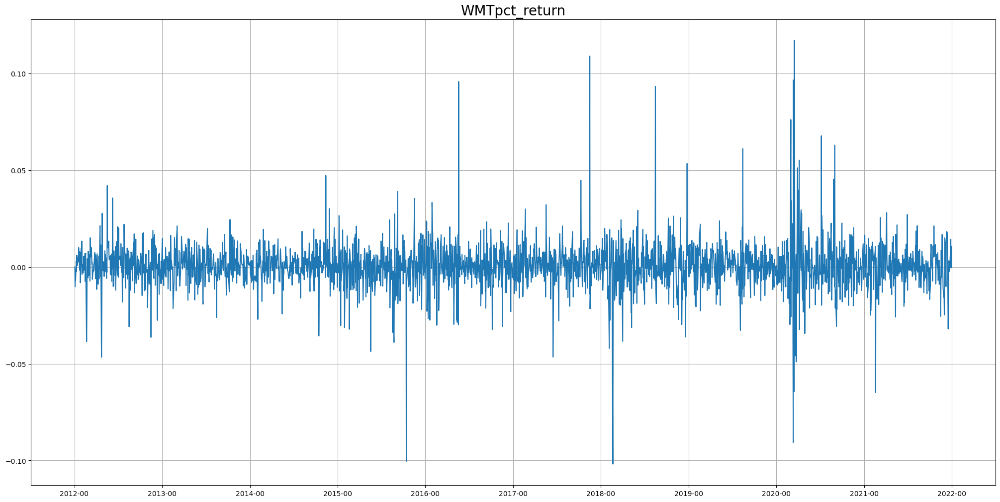

In [347]:
for tic in tics:
    plot_pct(dj30_dict[tic],tic)

/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  ax.plot(data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')),filtered_data)
/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  ax.plot(data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')),filtered_data)
/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecate

/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  ax.plot(data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')),filtered_data)
/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  ax.plot(data['date'][K:-K].apply(lambda x: datetime.strptime(x, '%Y-%m-%d')),filtered_data)
/tmp/ipykernel_3923687/4069440197.py:19: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecate

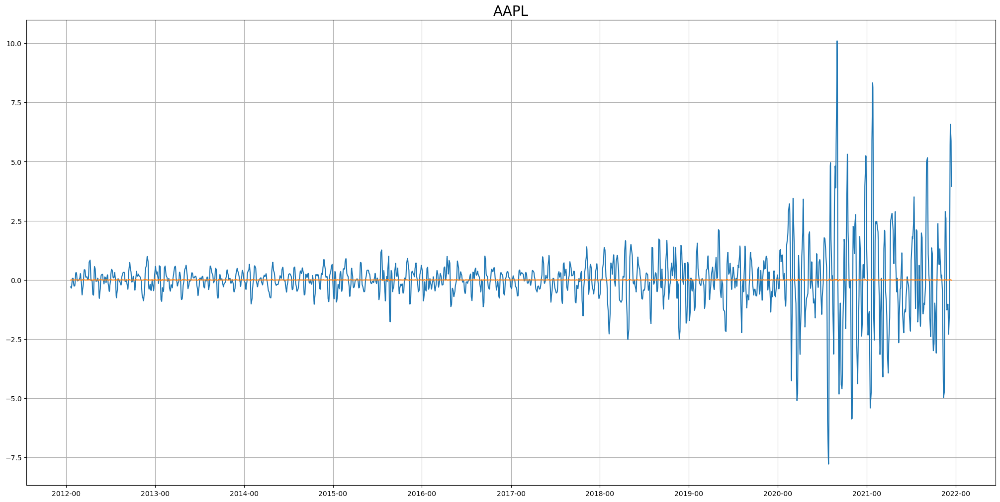

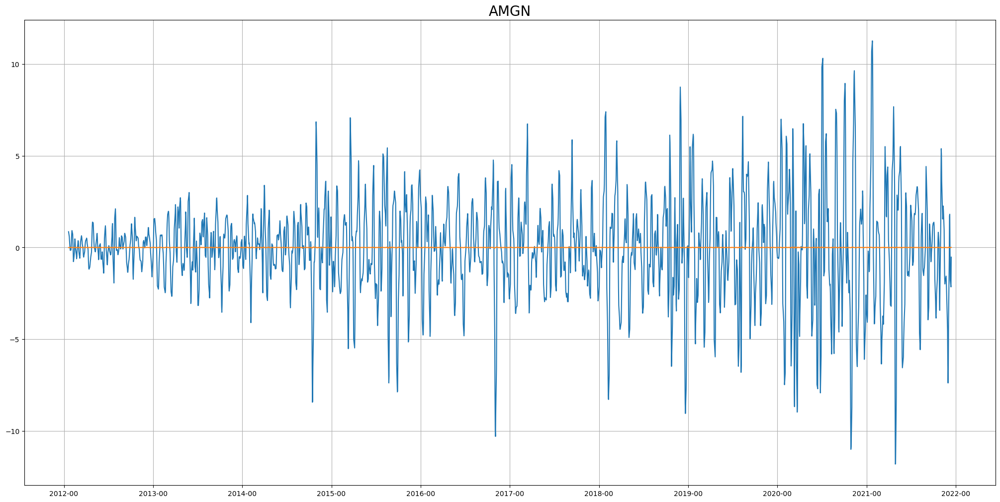

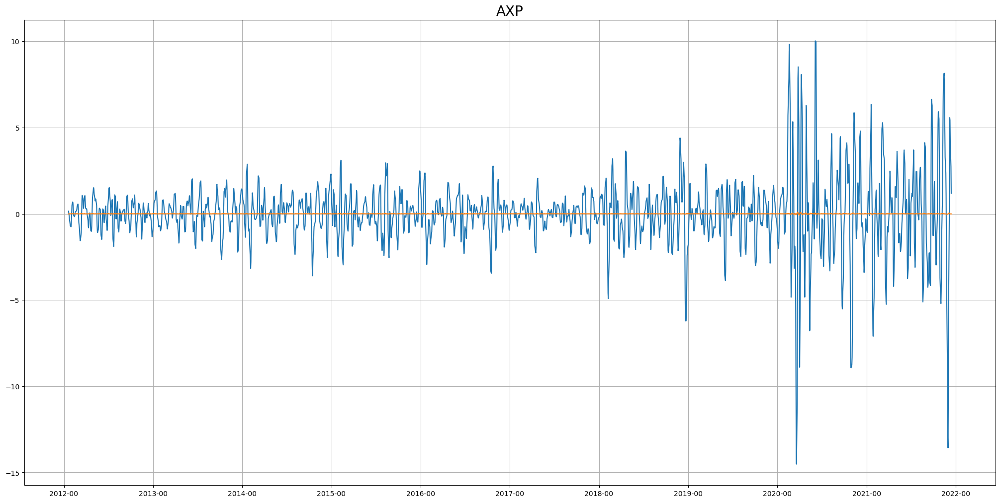

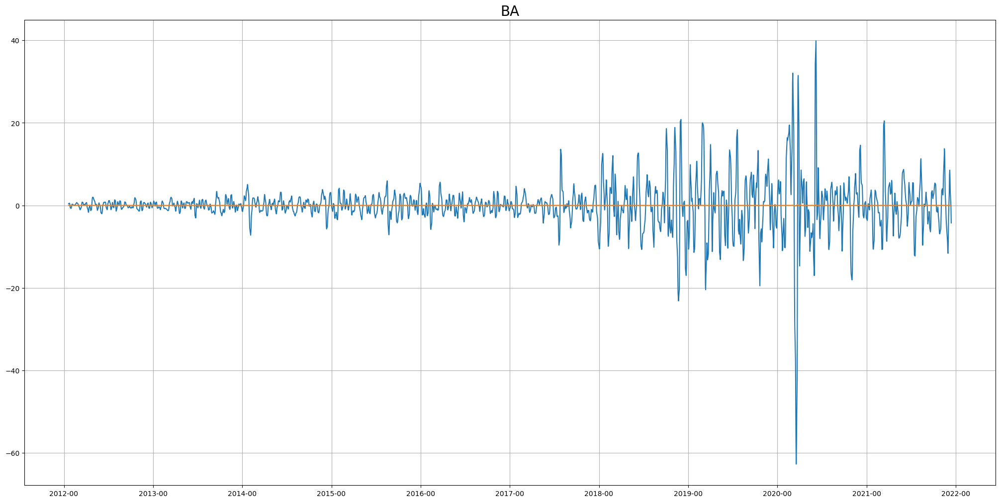

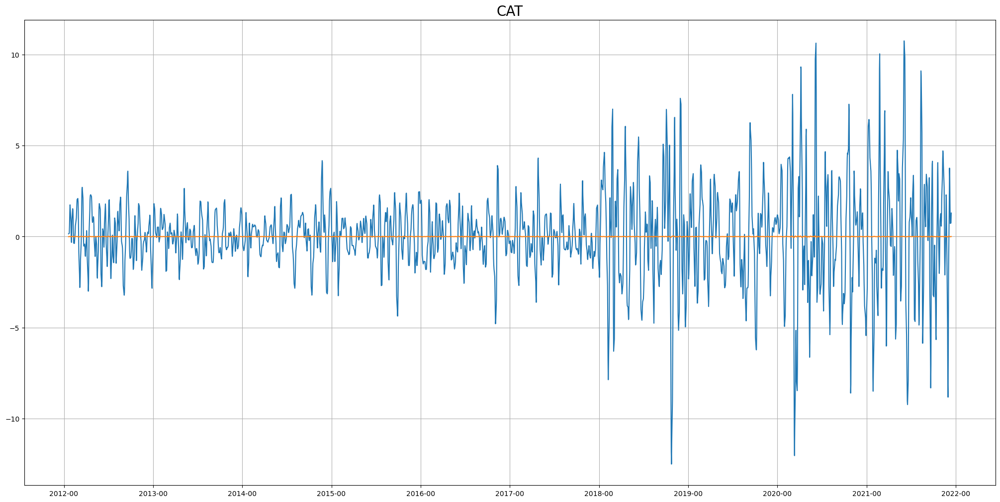

...

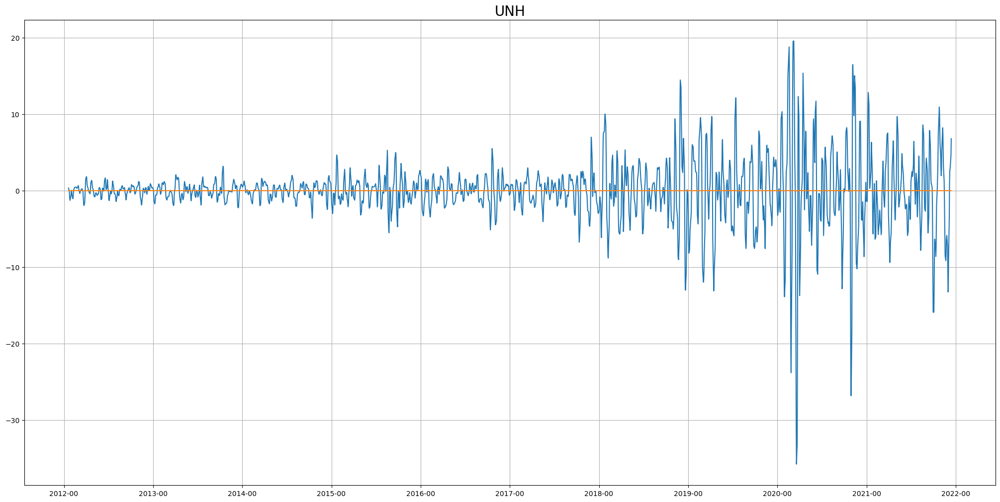

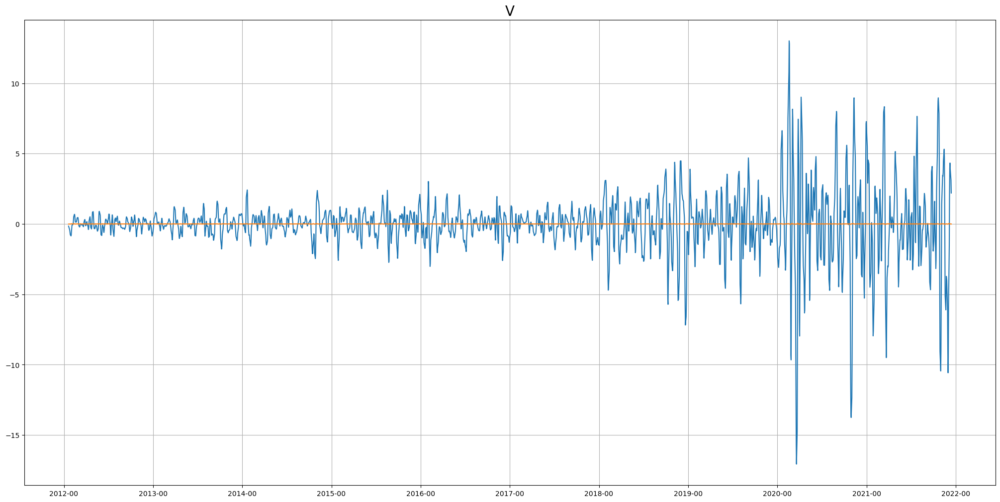

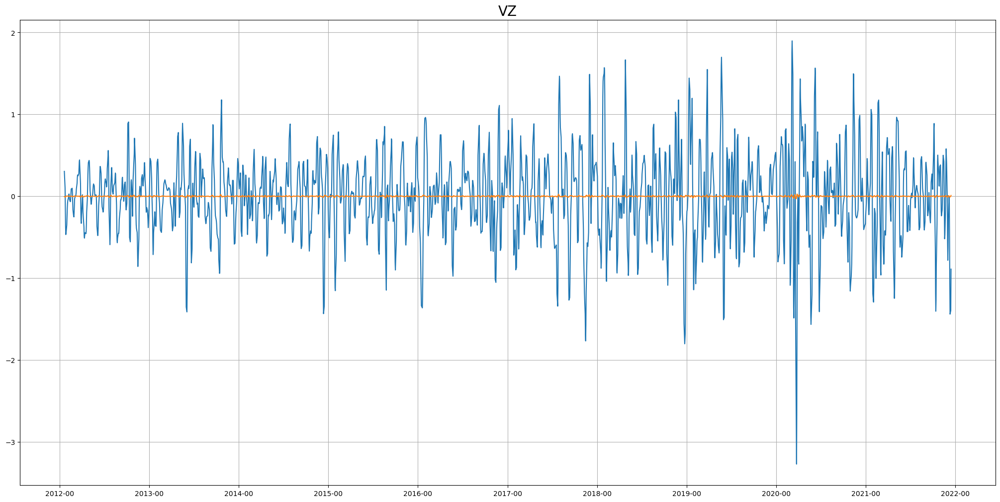

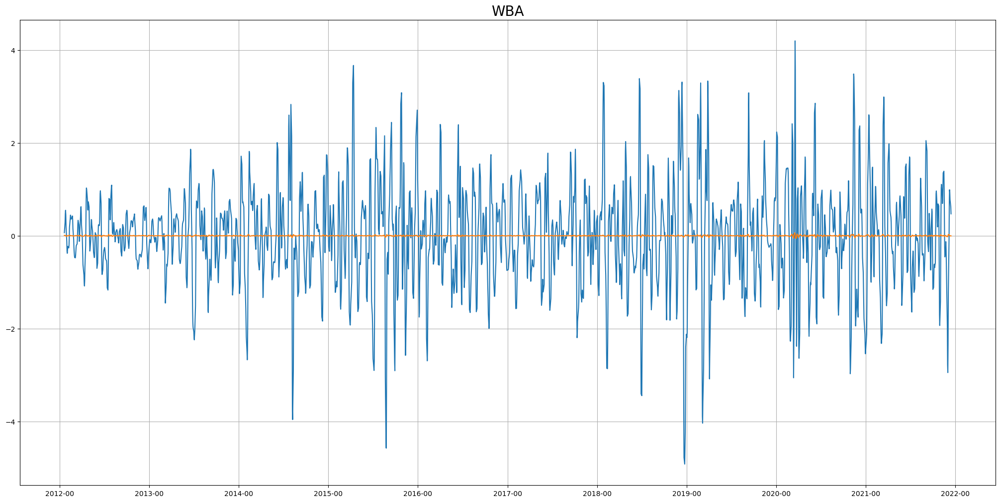

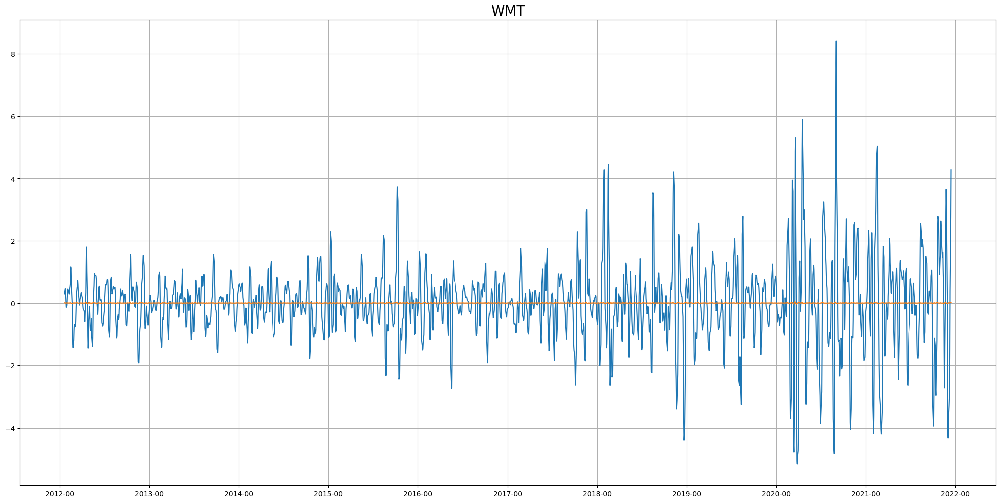

In [29]:
for tic in tics:
    plot_filter(dj30_dict[tic],tic)

# band-pass filter

In [18]:
for tic in tics:
    adjcp_apply_filter(dj30_dict[tic],Wn_adjcp=2/7,Wn_pct=2/30,order = 4)
    

/tmp/ipykernel_3923687/2397279041.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 1, figsize=(20, 10),constrained_layout=True)


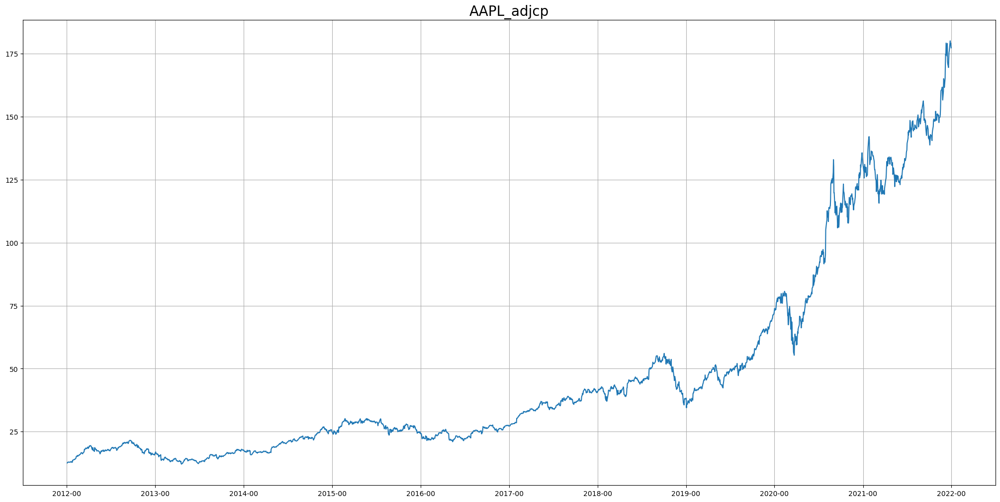

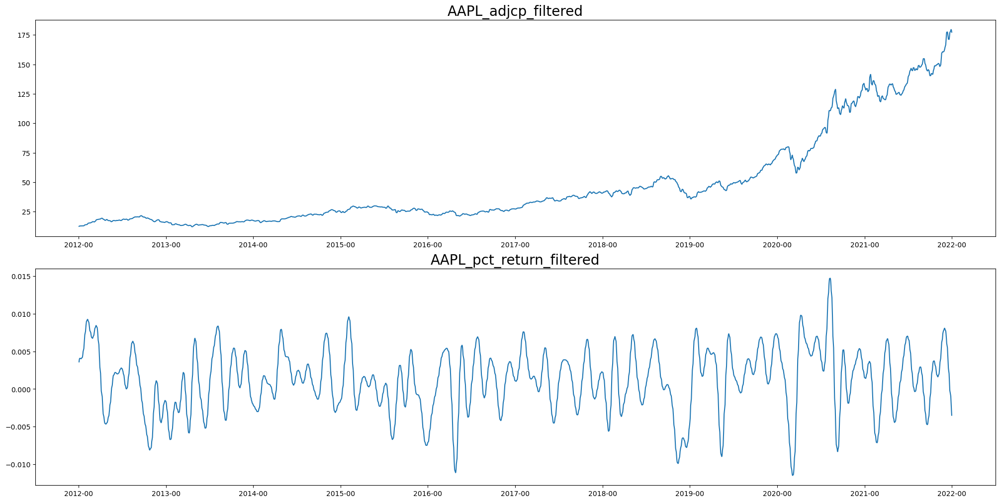

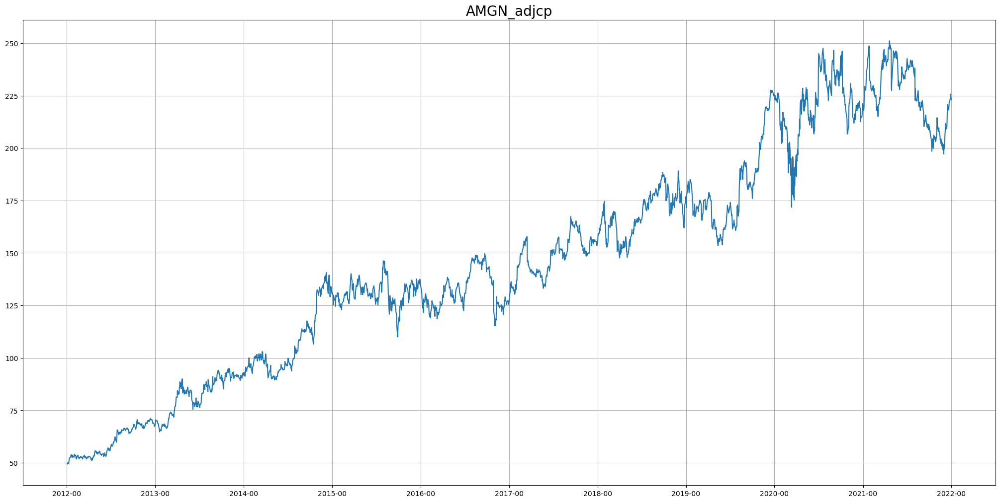

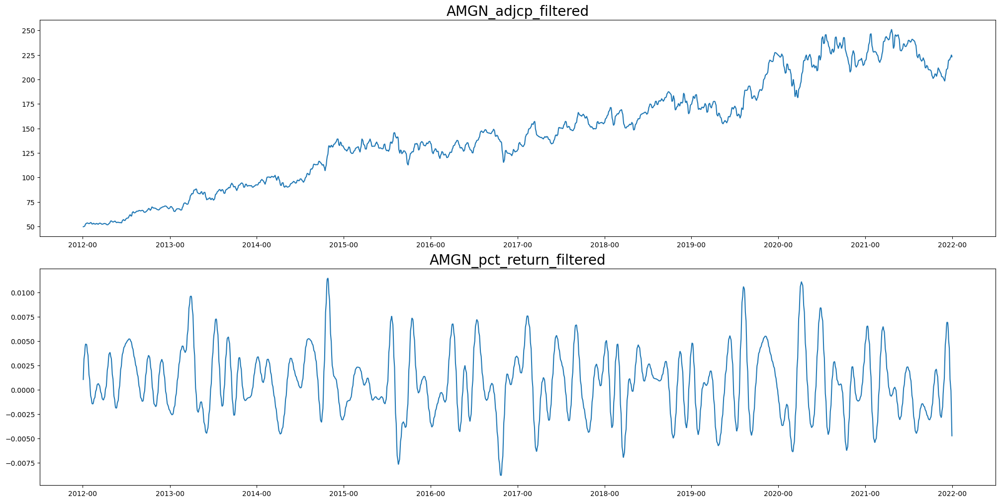

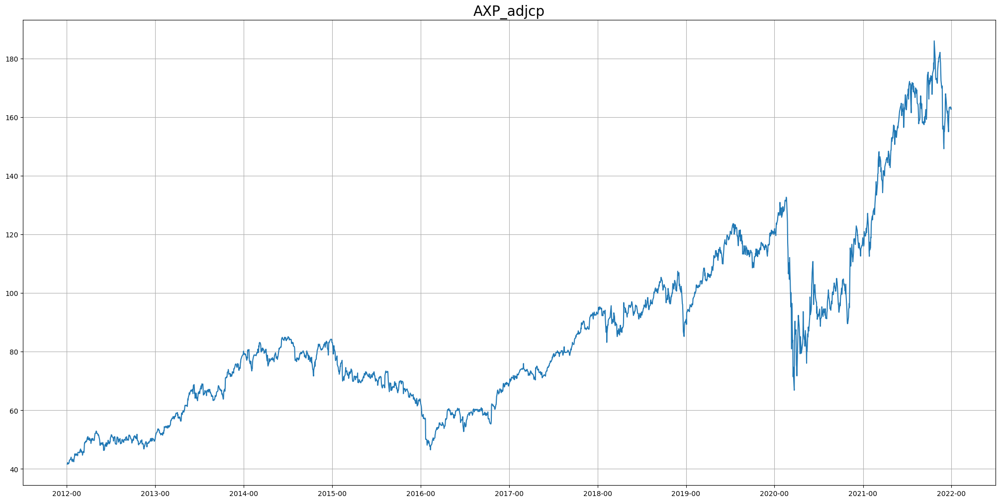

...

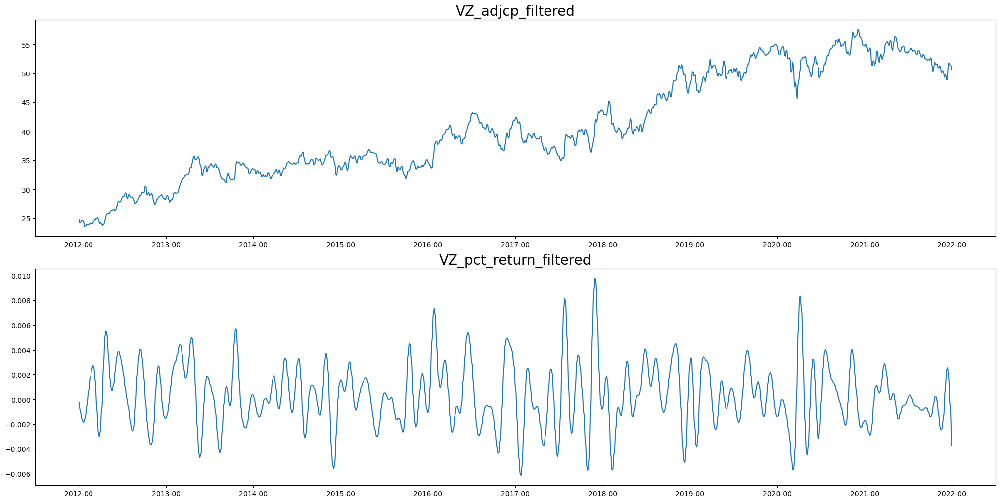

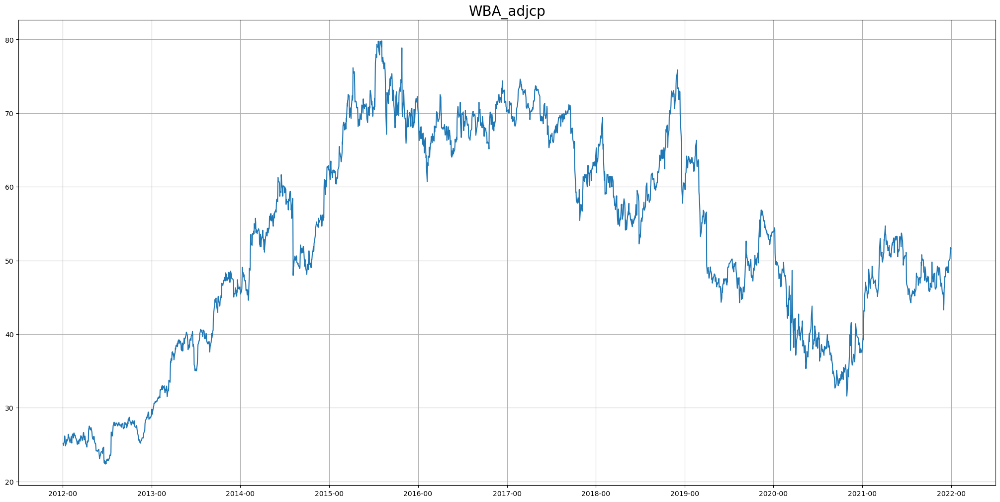

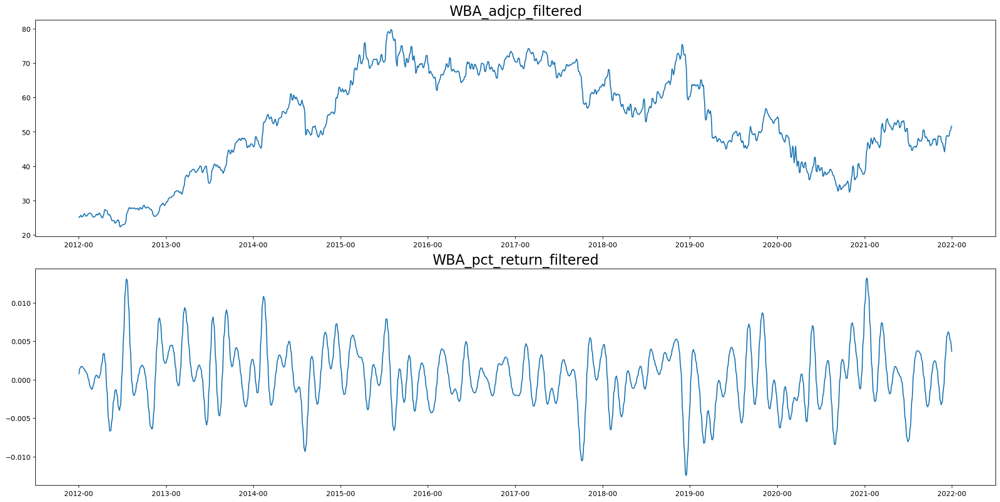

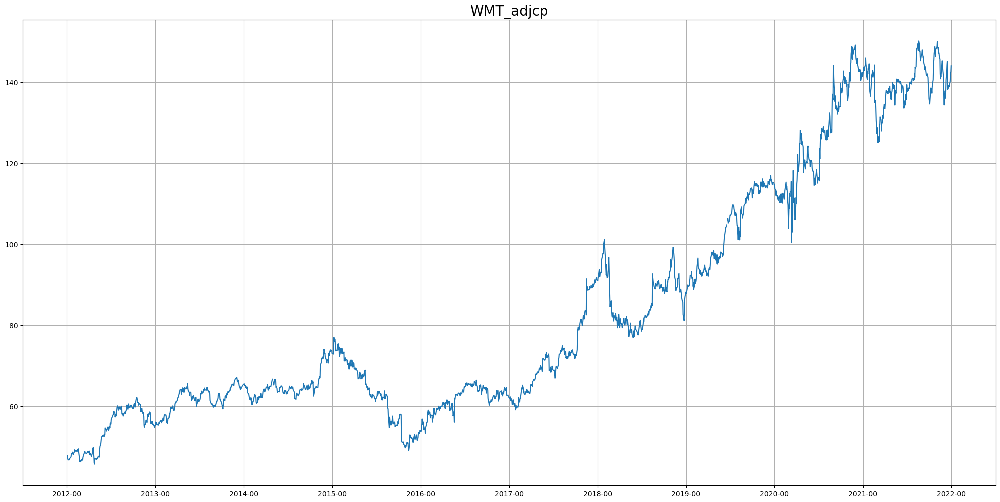

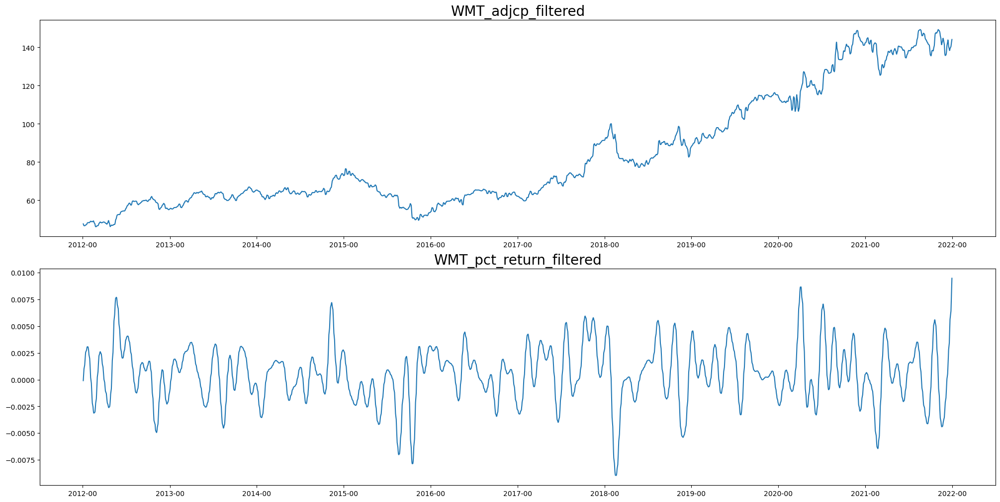

In [349]:
for tic in tics:
    plot_ori(dj30_dict[tic],tic)
    plot_lowpassfilter(dj30_dict[tic],tic)

# linear model 

first find turning points to segment the series,then use linear model to calculate slope 

get all slopes

In [472]:
turning_points_dict={}
coef_list_dict={}
y_pred_dict={}

In [477]:
for i,tic in enumerate(tics):
    coef_list,turning_points,y_pred_list=linear_regession_turning_points(data_ori=dj30_dict[tic],tic=tic)
    turning_points_dict[tic]=turning_points
    coef_list_dict[tic]=coef_list
    y_pred_dict[tic]=y_pred_list

In [478]:
all_coef_list=np.vstack([array for array in coef_list_dict.values()])

In [481]:
all_coef_list.shape

(2685, 1)

In [510]:
coef_stats=pd.DataFrame(all_coef_list).describe()
display(coef_stats)
percent_25=coef_stats.loc['25%',0]
percent_75=coef_stats.loc['75%',0]

,0
count,2685.000000
mean,-0.006382
std,0.593333
min,-10.661818
25%,-0.211832
50%,0.015504
75%,0.222965
max,3.453600


regime number: <25%=0   25%<0=1  0<75%=3 >75%=4

In [21]:
for tic in tics:
    turning_points=turning_points_dict[tic]
    coef_list=coef_list_dict[tic]
    y_pred_list=y_pred_dict[tic]
    linear_regession_plot(dj30_dict[tic],tic,y_pred_list,turning_points,percent_25,percent_75)

NameError: name 'turning_points_dict' is not defined

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


/tmp/ipykernel_3923687/1035216002.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)


21
22
23
24
25
26
27
28


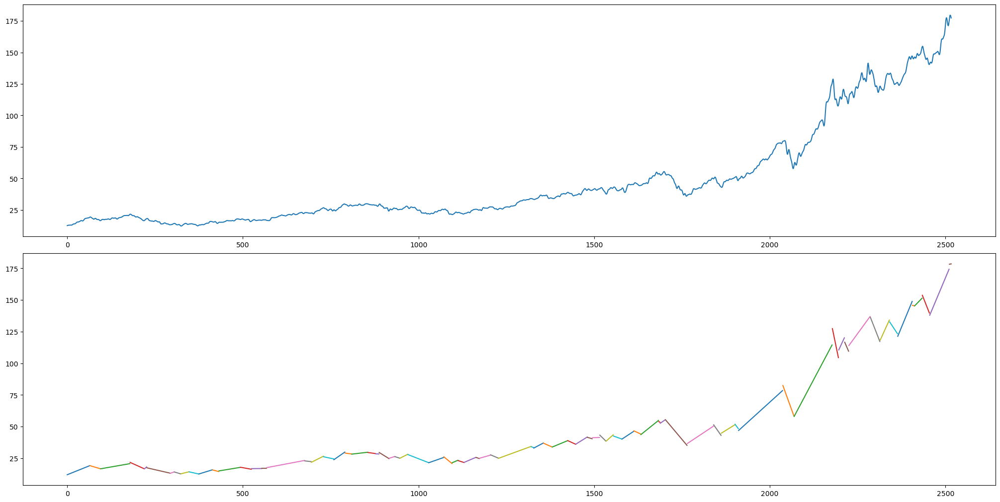

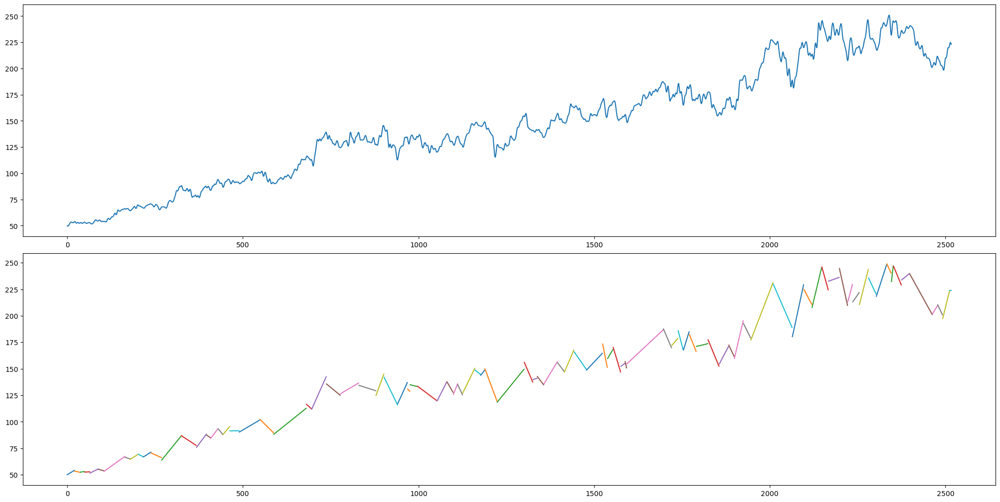

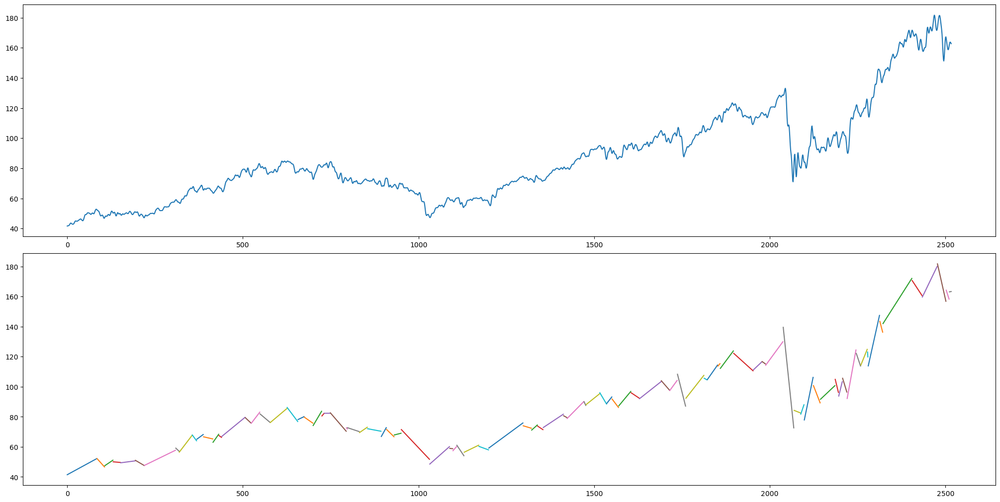

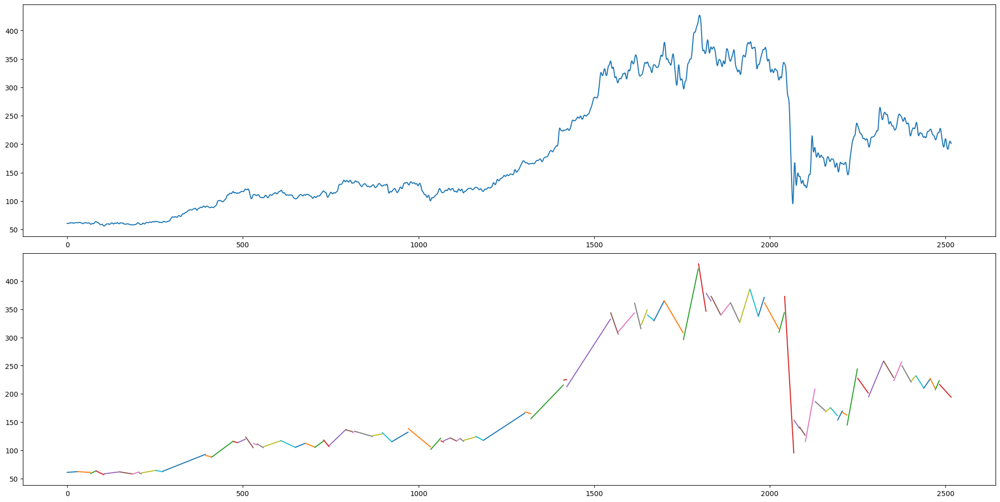

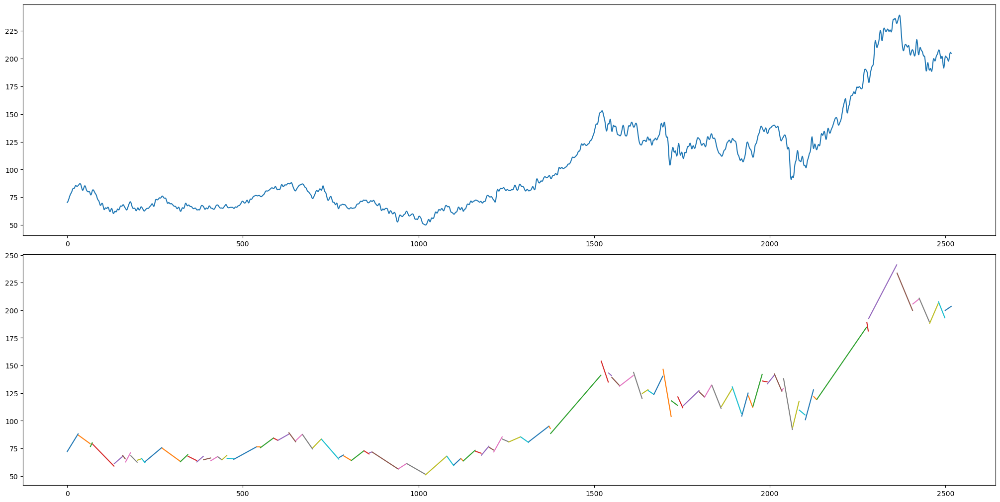

...

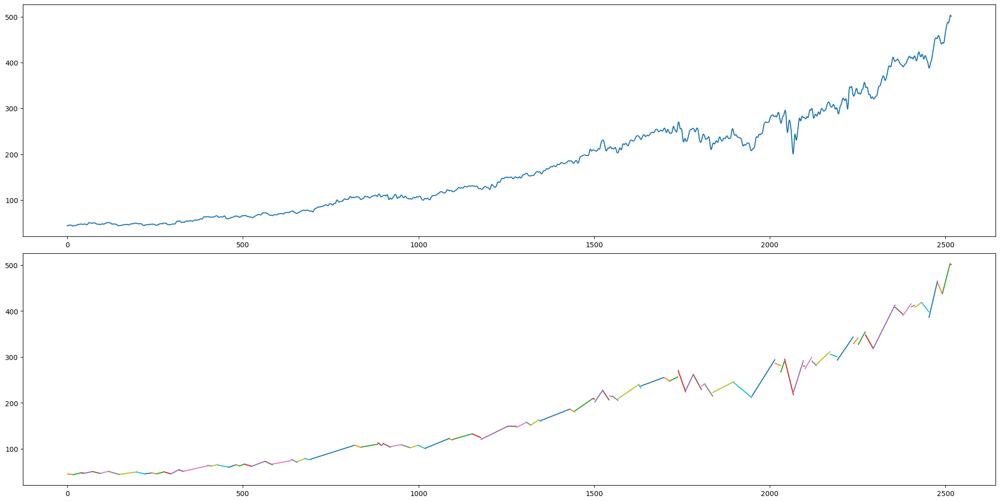

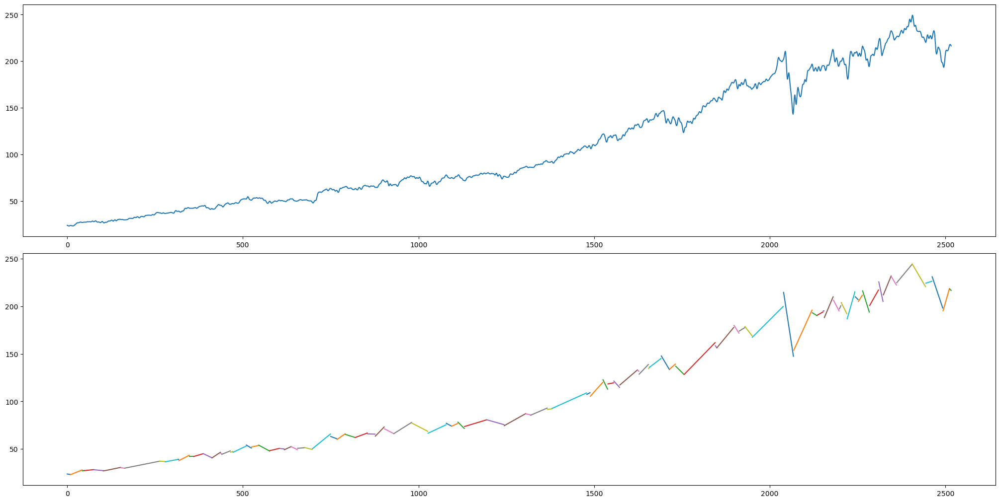

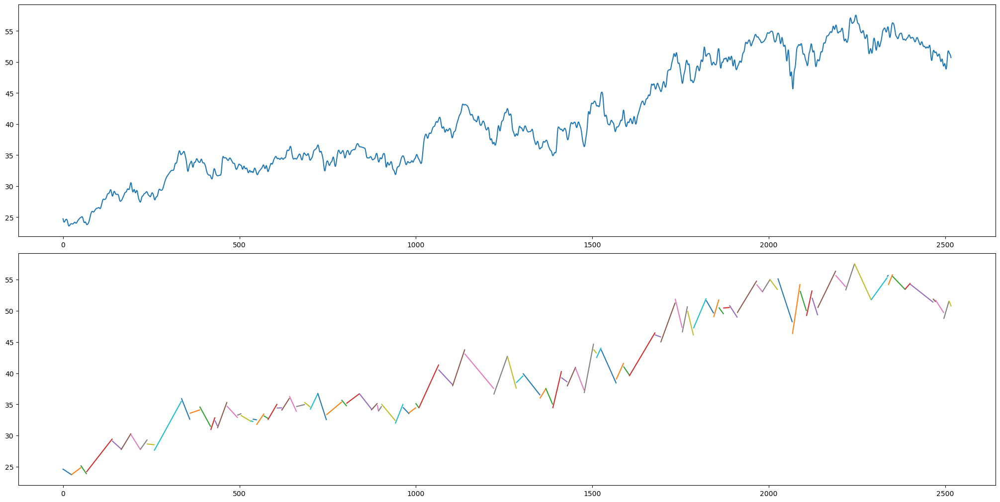

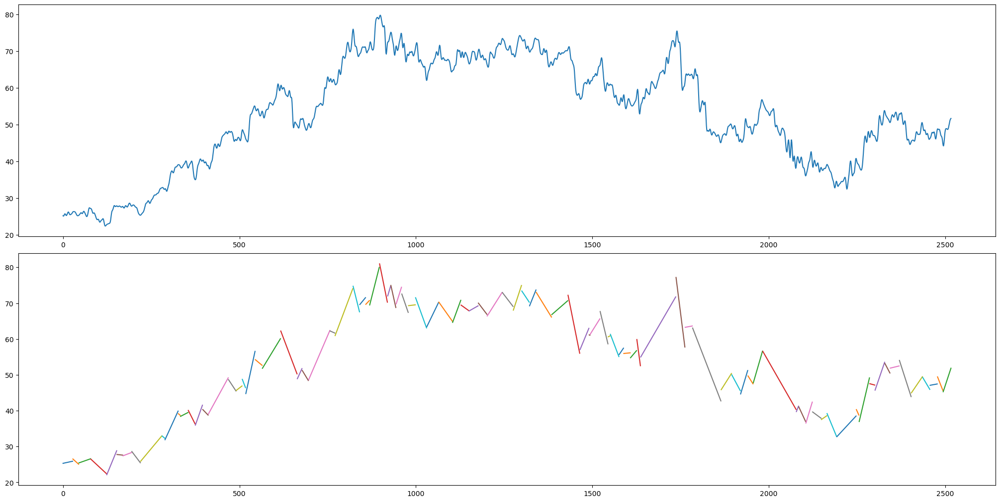

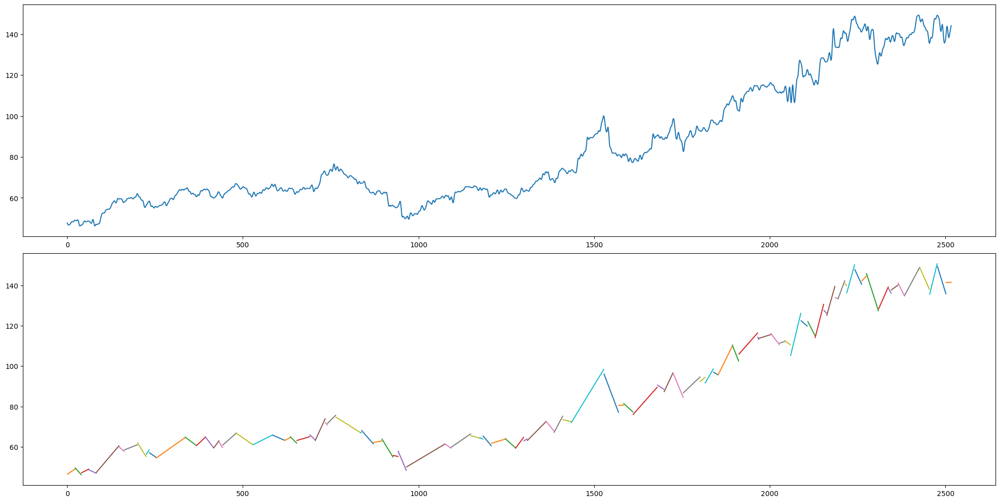

In [451]:
for i,tic in enumerate(tics):
    coef=linear_regession_turning_points(data_ori=dj30_dict[tic],tic=tic)
    print(i)
    if i>100:
        break

0


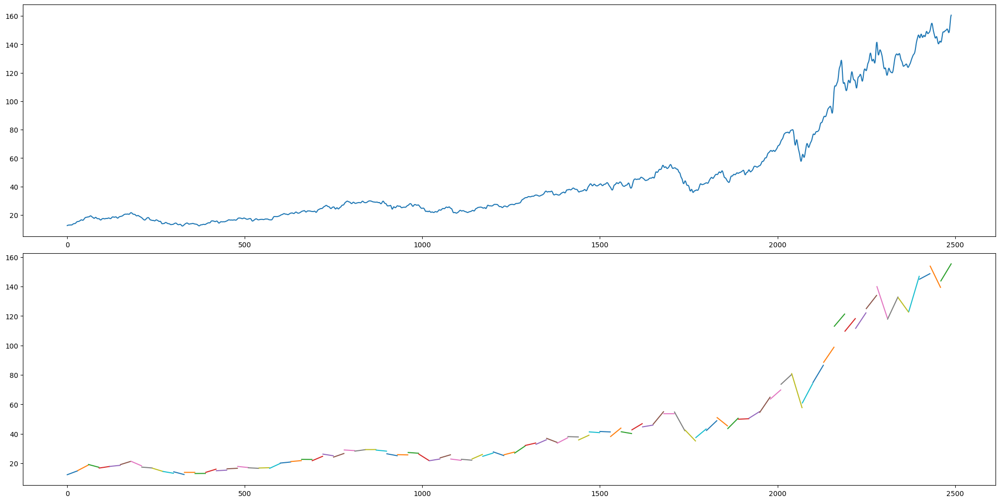

In [393]:
for i,tic in enumerate(tics):
    coef=linear_regession(data_ori=dj30_dict[tic],tic=tic,adjcp_timewindow=30)
#     print(coef)
    print(i)
    if i>-1:
        break

# DWT Clustering

In [22]:
for i,tic in enumerate(tics):
    dwt_clustering(cutoff=5,data_ori=dj30_dict[tic],tic=tic,adjcp_timewindow=30,pct_return_timewindow=30)
    print(i)
    if i>100:
        break

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28


/tmp/ipykernel_610742/2186297811.py:64: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(2, 1, figsize=(20, 10),constrained_layout=True)


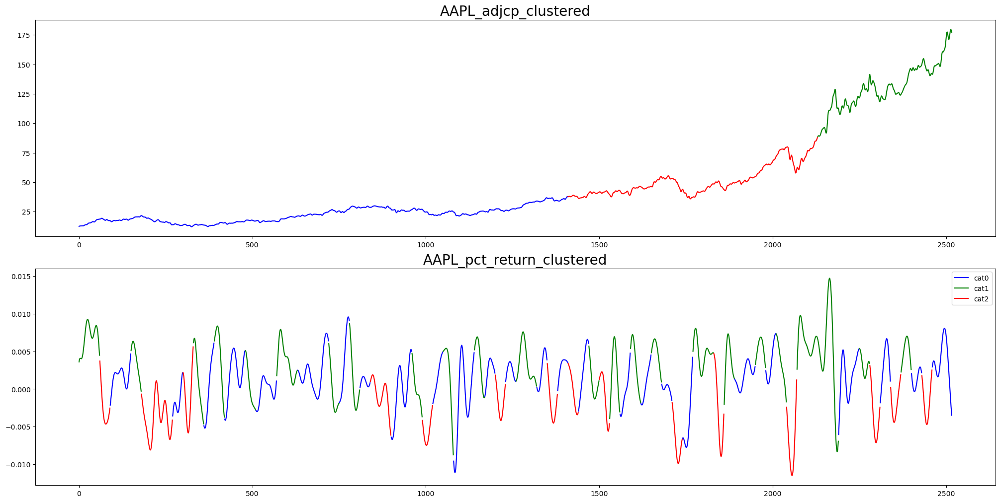

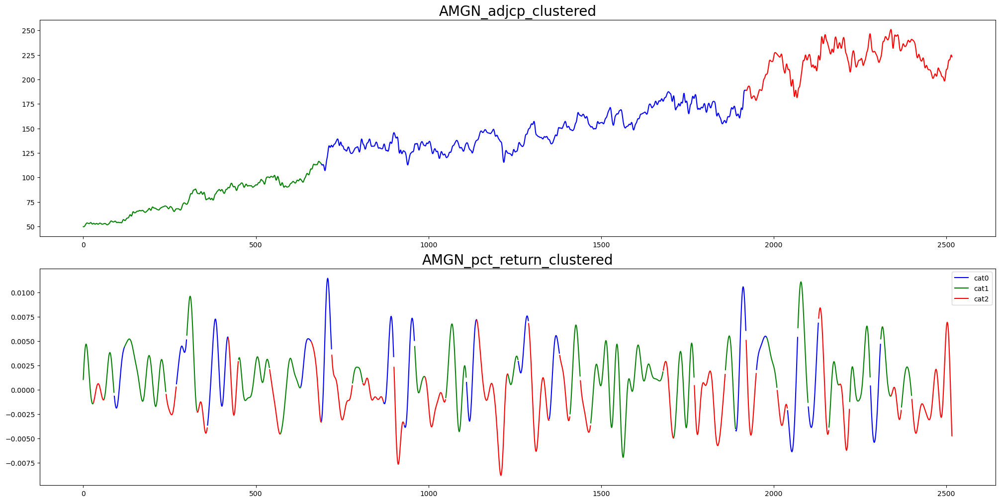

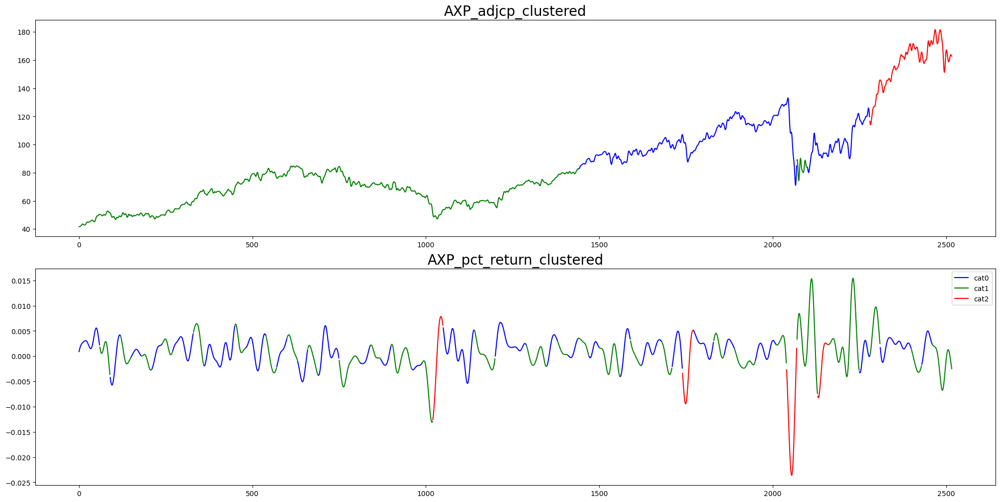

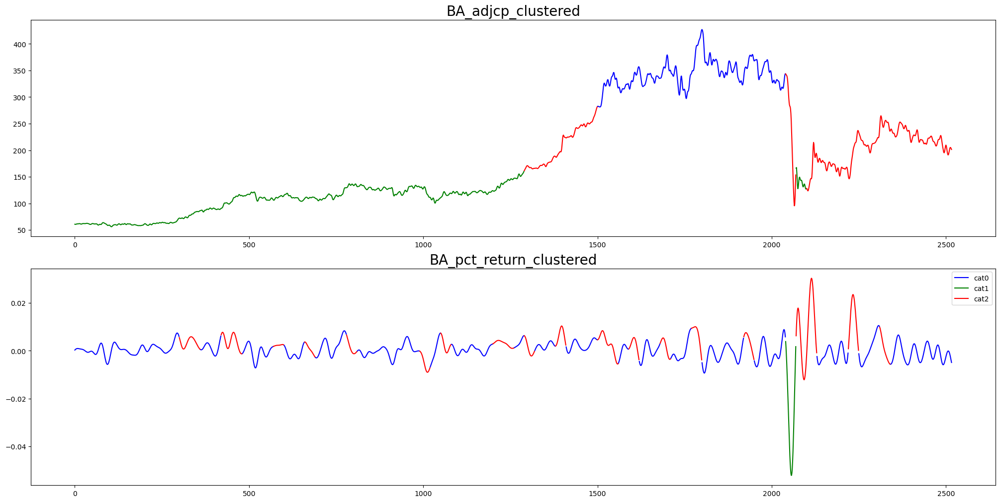

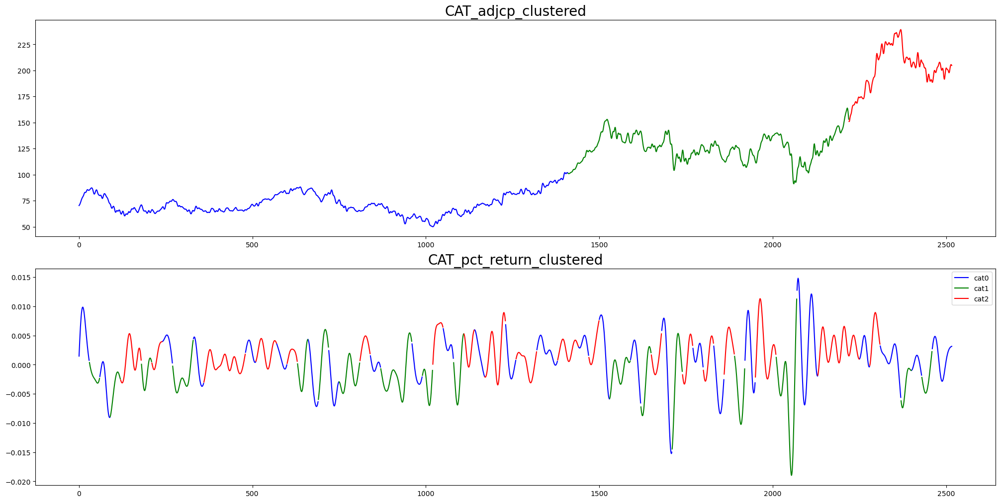

...

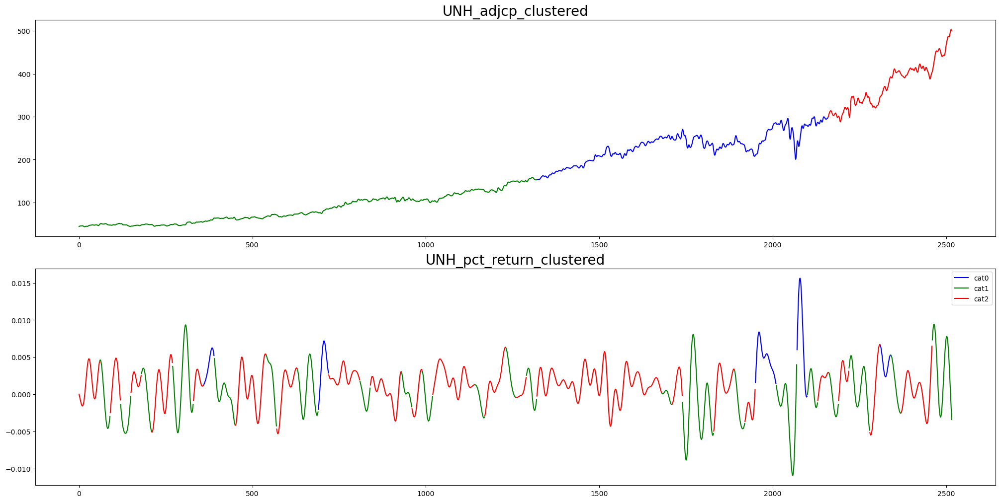

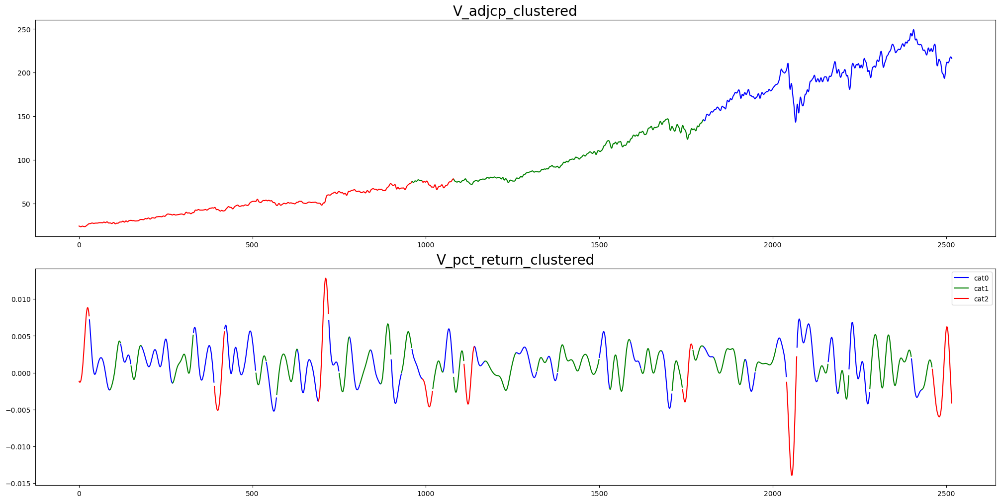

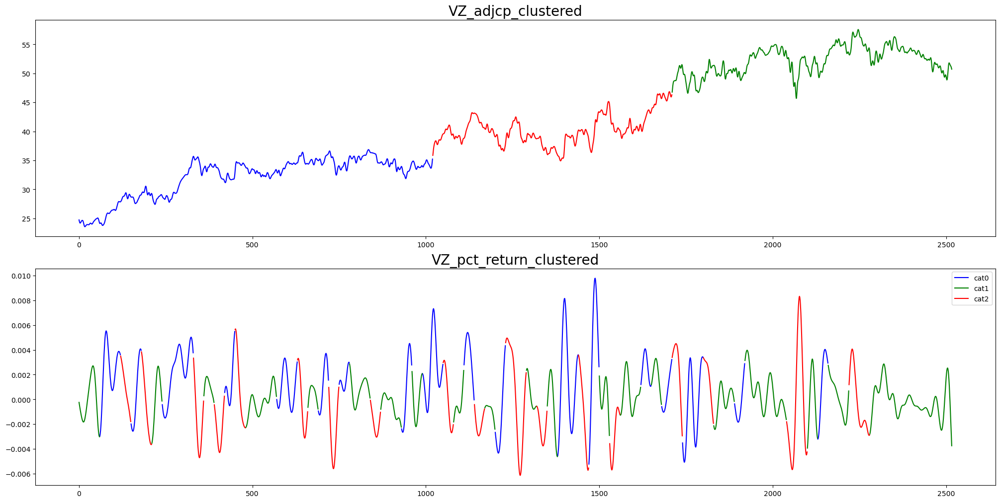

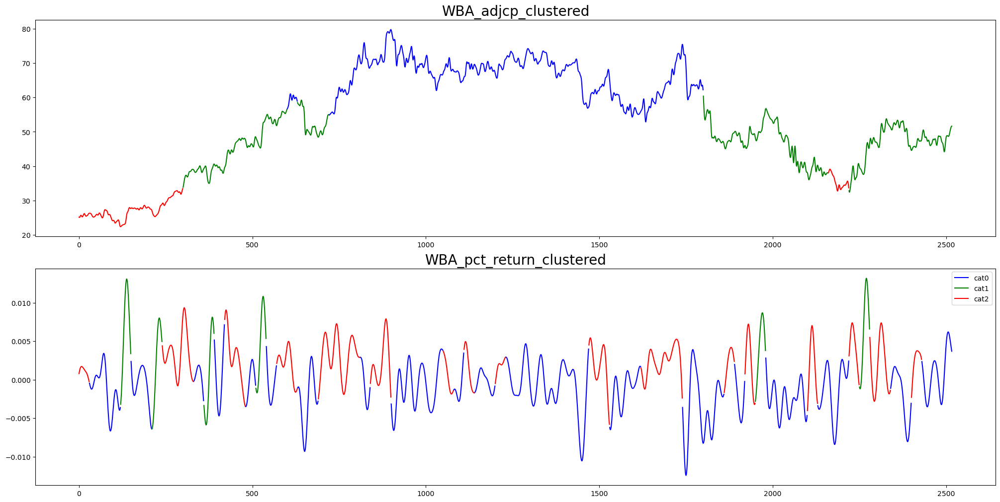

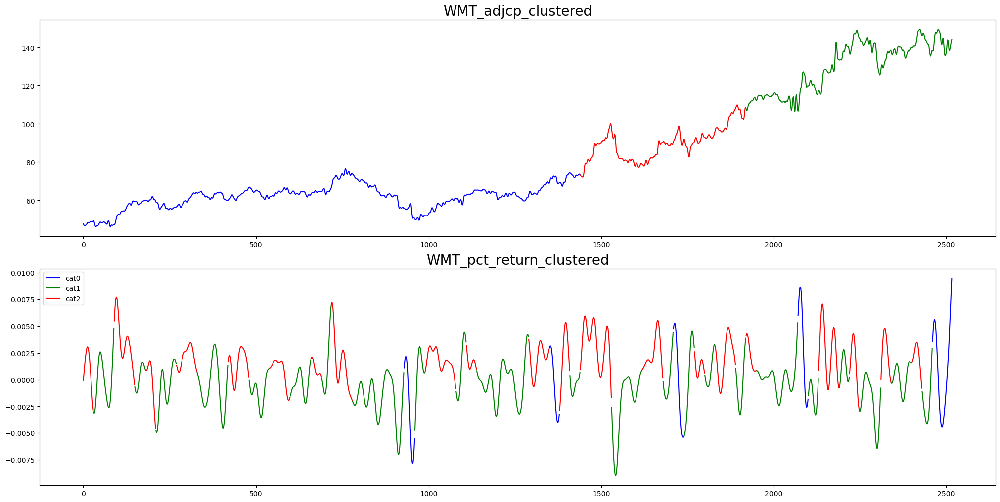

In [25]:
for i,tic in enumerate(tics):
    plot_with_cluster(dj30_dict[tic],tic)
    if i>100:
        break